### ¿Qué es RAG?

**RAG (Retrieval-Augmented Generation)** es una técnica avanzada en el campo de la inteligencia artificial generativa que potencia las capacidades de los LLM. Su objetivo principal es mejorar la precisión, actualidad y relevancia de las respuestas generadas por estos modelos, permitiéndoles acceder a información externa más allá de los datos con los que fueron entrenados.

**¿Cómo funciona RAG?**

El proceso de RAG se compone de tres etapas principales:

- Recuperación (Retrieval): Ante una consulta del usuario, el sistema busca información relevante en fuentes externas, como bases de datos, repositorios de documentos, o bases de datos vectoriales. Esta búsqueda puede realizarse mediante técnicas de búsqueda semántica, embeddings o consultas tradicionales.
- Augmentación (Augmentation): La información recuperada se combina con la consulta original del usuario, creando un contexto enriquecido que se utiliza como entrada para el modelo de lenguaje.
- Generación (Generation): El LLM genera una respuesta utilizando tanto su conocimiento interno como la información externa proporcionada, lo que permite respuestas más precisas, actualizadas y con posibilidad de citar fuentes específicas.

**Ventajas de RAG**

- Actualización y precisión: Permite que los LLM accedan a información reciente y específica de dominio sin necesidad de reentrenar el modelo, lo que ahorra recursos y tiempo.
- Reducción de alucinaciones: Al basar las respuestas en datos recuperados, disminuye la probabilidad de que el modelo genere información incorrecta o inventada.
- Transparencia y verificabilidad: RAG puede incluir citas o referencias a las fuentes de la información, facilitando la verificación de la respuesta por parte del usuario.
- Adaptabilidad: Es posible personalizar el sistema para que consulte bases de datos internas, repositorios corporativos o cualquier fuente relevante para el contexto de uso.

**Ejemplo de aplicación**

Imagina una empresa que necesita que su chatbot responda preguntas sobre normativas internas. Un sistema RAG permite que el LLM consulte documentos internos actualizados y genere respuestas precisas, citando la fuente correspondiente, sin exponer la información a internet ni requerir reentrenamiento del modelo.

En resumen, RAG es una arquitectura fundamental para aprovechar al máximo los LLM en contextos donde la precisión, la actualidad y la trazabilidad de la información son críticas, especialmente en entornos corporativos, legales, médicos y de atención al cliente.


### Introducción

Este proyecto tiene como objetivo crear un sistema que permita incorporar recetas de cocina a una base de datos vectorial para su posterior consulta. Utilizando técnicas de RAG, se busca mejorar la precisión y relevancia de las respuestas generadas al consultar recetas específicas.

### Setup

In [1]:
from dotenv import load_dotenv
import os

load_dotenv(override=True)
gemini_api_key = os.getenv('GOOGLE_API_KEY')

In [2]:
# Import the libraries
from openai import OpenAI
import base64

In [3]:
# Set up connection to OpenAI API
chat_client = OpenAI(
    api_key=gemini_api_key, # Use the provided API key for authentication
    base_url="https://generativelanguage.googleapis.com/v1beta" 
)
# Specify the model to be used
model = "gemini-2.5-flash-preview-05-20"

### Realizar OCR y transformar a imágenes

Algunos PDFs se crean a partir de texto escaneados o mediante imágenes. Para estos casos, es necesario realizar un OCR (Reconocimiento Óptico de Caracteres) para extraer el texto de las imágenes. Incluso si el PDF mezcla texto e imágenes a veces es recomendable usar OCR ya que así el LLM puede entender mejor el contenido.

A la siguiente función se le pasa un PDF y se trocea en páginas. Cada página se convierte a imagen.

In [5]:
from pdf2image import convert_from_path

# Function to converts pdfs into images and stores the image paths
def pdf_to_images(pdf_path, output_folder):
  # Create the output folder if it doesn't exist
  if not os.path.exists(output_folder):
    os.makedirs(output_folder)

  # Convert PDF into images
  images = convert_from_path(pdf_path) # Convert each page of the PDF to an image
  image_paths = []

  # Save images and store their paths
  for i, image in enumerate(images):
    image_path = os.path.join(output_folder, f"page{i+1}.jpg") # Generate the image file path
    image.save(image_path, "JPEG") # Save the image as a JPEG file
    image_paths.append(image_path) # Append the image path to the list

  return image_paths # Return the list of image paths

In [7]:
# Define the path to the PDF and the output folder for images
book_name = "Southern Cookbook of Fine Recipes"
pdf_path = f"../pdfs/recipes/{book_name}.pdf"
output_folder = f"../imgs/recipes/{book_name}"

# Convert the PDF into images and store the image paths
image_paths = pdf_to_images(pdf_path, output_folder)

Leemos una imagen y obtenemos el Base64 de la imagen.

In [13]:
# Read and encode one image
book_page = 22 # Specify the page number to read
image_file = os.path.join(output_folder, f"page{book_page}.jpg") # Path to the image to be encoded

# Encode the image in base64 and decode to string
with open(image_file, "rb") as image_file:
  image_data = base64.b64encode(image_file.read()).decode('utf-8')
image_data

'/9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBwcJCQgKDBQNDAsLDBkSEw8UHRofHh0aHBwgJC4nICIsIxwcKDcpLDAxNDQ0Hyc5PTgyPC4zNDL/2wBDAQkJCQwLDBgNDRgyIRwhMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjIyMjL/wAARCAbLBGgDASIAAhEBAxEB/8QAHwAAAQUBAQEBAQEAAAAAAAAAAAECAwQFBgcICQoL/8QAtRAAAgEDAwIEAwUFBAQAAAF9AQIDAAQRBRIhMUEGE1FhByJxFDKBkaEII0KxwRVS0fAkM2JyggkKFhcYGRolJicoKSo0NTY3ODk6Q0RFRkdISUpTVFVWV1hZWmNkZWZnaGlqc3R1dnd4eXqDhIWGh4iJipKTlJWWl5iZmqKjpKWmp6ipqrKztLW2t7i5usLDxMXGx8jJytLT1NXW19jZ2uHi4+Tl5ufo6erx8vP09fb3+Pn6/8QAHwEAAwEBAQEBAQEBAQAAAAAAAAECAwQFBgcICQoL/8QAtREAAgECBAQDBAcFBAQAAQJ3AAECAxEEBSExBhJBUQdhcRMiMoEIFEKRobHBCSMzUvAVYnLRChYkNOEl8RcYGRomJygpKjU2Nzg5OkNERUZHSElKU1RVVldYWVpjZGVmZ2hpanN0dXZ3eHl6goOEhYaHiImKkpOUlZaXmJmaoqOkpaanqKmqsrO0tba3uLm6wsPExcbHyMnK0tPU1dbX2Nna4uPk5ebn6Onq8vP09fb3+Pn6/9oADAMBAAIRAxEAPwD3elFGKK8g0CiiimAUUUUAFFFFMAooooAKKKKACiiigAooooAKKKKACiiigAooooAKKKKACiiigAooooAKKKKACiiigAooooAKKKKACiiigAooooAKKKKACiiigAooooAKKKKACiiigAooooAKKKKACiiigAooooAKKKKACii

Definimos el `system_prompt`:

In [9]:
# Define the system prompt
system_prompt = """
Por favor, analiza el contenido de esta imagen y extrae cualquier información relacionada con recetas.
La salida se espera completa en español: Nombre de la receta, ingredientes y preparación.
Si una receta no tiene ingredientes, obténgalos de la preparación.
"""

Llamamos al LLM. Observe cómo se pasa la imagen en Base64.

In [ ]:
# Call the OpenAI API use the chat completion method
response = chat_client.chat.completions.create(
    model = model,
    messages = [
        # Proporciona el mensaje del sistema
        {"role": "system", "content": system_prompt},

        # El mensaje del usuario contiene tanto el texto como la URL / ruta de la imagen
        {"role": "user", "content": [
            {"type": "text", "text": "Esta es la imagen de la página de la receta."},
            {"type": "image_url",
             "image_url": {"url": f"data:image/jpeg;base64,{image_data}",
                           "detail": "low"}}
        ]}
    ]
)

gpt_response = response.choices[0].message.content

In [16]:
from IPython.display import Markdown, Image, HTML, display

import markdown2

def display_image_and_text(image_path, text_html):
    """Display an image and text side by side"""
    image_html = f'<img src="{image_path}" width="300" style="vertical-align:top; margin-right:20px;">'

    display(HTML(f"""
    <div style="display:flex; align-items:flex-start;">
        {image_html}
        <div style="margin-left:20px;">{text_html}</div>
    </div>
    """))

text_html = markdown2.markdown(gpt_response)
display_image_and_text(image_file.name, text_html)

Creamos una función para mostrar el resultado de la llamada al LLM.

In [17]:
# Define a function to get the GPT response and display it in Markdown
def get_gpt_response():
  gpt_response = response.choices[0].message.content # Extract the response content from the API response
  return display(Markdown(gpt_response)) # Display the response as Markdown

# Call the function to display the GPT response
get_gpt_response()

Aquí tienes el análisis de las recetas de la imagen, con su nombre, ingredientes y preparación en español:

---

### **1. Royal Poincianna Pompano con Relleno de Camarones**

**Nombre de la receta:** Royal Poincianna Pompano con Relleno de Camarones

**Ingredientes:**
*   2 tazas de camarones cocidos
*   2 huevos
*   1 taza de crema rica
*   1 pámpano deshuesado
*   ½ taza de champiñones picados
*   ¼ taza de vino de jerez
*   Pimienta, sal y pimentón
*   Pepinos en rodajas (para guarnición)
*   Aderezo francés (para marinar los pepinos)

**Preparación:**
Limpie los camarones y páselos por la picadora de carne. Bata un huevo y la mitad de la crema. Mezcle los camarones, los champiñones y los condimentos (pimienta, sal, pimentón) y revuelva con la crema y el huevo hasta obtener una pasta suave. Coloque la mezcla en una de las mitades del pámpano. Cose las dos mitades del pescado y póngalo en una fuente para hornear. Vierta la crema restante sobre el pescado y hornee en un horno moderado durante 45 minutos. Sirva guarnecido con pepinos en rodajas que hayan sido marinados en aderezo francés.

---

### **2. Estofado de Tortuga Diamante (Estilo Bahía de Chesapeake)**

**Nombre de la receta:** Estofado de Tortuga Diamante (Estilo Bahía de Chesapeake)

**Ingredientes:**
*   3 tortugas (grandes)
*   6 huevos duros
*   3 cucharadas de harina
*   ½ nuez moscada rallada
*   1 cebolla, en rodajas
*   ½ taza de mantequilla
*   1 limón (jugo y cáscara)
*   2 tallos de apio
*   2 tazas de jerez de cocina
*   1 cucharada de salsa Worcestershire
*   Caldo de sopa
*   Pimiento rojo y sal
*   Crema
*   Leche caliente

**Preparación:**
Sumerja la tortuga viva en agua hirviendo y déjela reposar durante 5 minutos. Retírela del agua, frote la piel de las patas, la cola y la cabeza con una toalla, sacando la cabeza con un pincho. Quite las garras. Friegue la concha con agua hirviendo. Rompa la concha con un hacha afilada. Retire la carne y el hígado. Deseche la vesícula biliar, el corazón, la bolsa de arena y las vísceras. Corte el hígado en rodajas finas. Saque los huevos, retire la película y póngalos en agua fría. Combine las yemas de huevo, la cebolla, el apio y la harina, y el caldo de sopa (suficiente para cubrir la carne); agregue el limón, la nuez moscada, los huevos de tortuga y la carne. Luego agregue la crema, el jerez, la salsa Worcestershire y los condimentos. Agregue las claras de huevo picadas y suficiente leche caliente para diluir el estofado si se vuelve demasiado espeso. Cocine a fuego lento en una olla doble hasta que la carne se desprenda de los huesos (aproximadamente 15 minutos). Retire todos los huesos antes de servir. Sirva en una fuente de rechaud con tostadas al lado.

---

### **3. Pasteles de Pescado**

**Nombre de la receta:** Pasteles de Pescado

**Ingredientes:**
*   2 tazas de pescado frío hervido, desmenuzado
*   2 tazas de puré de patatas
*   1 cucharada de mantequilla
*   1 huevo batido
*   Sal y pimienta
*   Harina

**Preparación:**
Cualquier pescado fresco apto para hervir puede usarse, aunque se prefiere el bacalao. Mezcle todos los ingredientes, forme tortas redondas y planas y páselas por harina. Luego fríalas en mantequilla por ambos lados y sirva con salsa de tomate (receta en la página 24).

---

### **4. Arenque con Huevas**

**Nombre de la receta:** Arenque con Huevas

**Ingredientes:**
*   Arenque (con huevas)
*   Agua fría
*   Harina
*   Mantequilla
*   Perejil (para guarnición)
*   Limón en rodajas (para guarnición)

**Preparación:**
Cubra el arenque con agua fría y déjelo en remojo durante la noche. Escurra. Pase el pescado ligeramente por harina y colóquelo en una fuente para hornear. Ponga trozos de mantequilla y cocine en horno caliente (400° F.) hasta que esté tierno. Coloque en un plato caliente; sirva con un poco de mantequilla derretida vertida sobre el pescado. Adorne con perejil y limón en rodajas.

---

### **5. Caballa Española Asada a la Parrilla (Estilo Baltimore)**

**Nombre de la receta:** Caballa Española Asada a la Parrilla (Estilo Baltimore)

**Ingredientes:**
*   Caballa española
*   Pimienta
*   Sal
*   Cayena
*   3 cucharadas de mantequilla derretida (para la salsa)
*   ½ limón (jugo, para la salsa)

**Preparación:**
Lave la caballa y pártala por la mitad. Sazone el pescado con pimienta y sal y colóquelo en una parrilla bien engrasada en un horno para asar (550° F.). Asa por ambos lados hasta que esté tierna. Coloque en un plato caliente y espolvoree con cayena y sirva con una salsa hecha de tres cucharadas de mantequilla derretida y el jugo de ½ limón.

---

### **6. Filetes de Pescado Lenguado**

**Nombre de la receta:** Filetes de Pescado Lenguado

**Ingredientes:**
*   5 filetes de lenguado
*   3 cucharadas de mantequilla
*   1 taza de leche
*   Pan rallado (tamizado)
*   1 huevo
*   1 taza de salsa de tomate
*   Sal y pimienta

**Preparación:**
Combine el huevo, la leche, la sal y la pimienta y remoje el pescado en esta mezcla durante quince minutos. Sumerja cada filete en el pan rallado. Deje que la sartén con mantequilla se caliente antes de colocar los filetes en ella. Fría por ambos lados hasta que estén dorados, luego vierta la salsa de tomate sobre todos (receta para la salsa de tomate en la página 24).

Definimos un `prompt` mejorado.

In [18]:
system_prompt = """
Eres un asistente que extrae recetas en formato estructurado según el esquema proporcionado.
Si una receta no tiene ingredientes, los obtienes de la preparación.
Los valores de todos los campos, incluido recipe_name, estarán en español,
excepto book_name, que estará en el idioma original.
Si algún campo no está presente en la información, pon valor None.
Por ejemplo, campos como los siguientes deben ponerse con None:
- 'quantity': 'al gusto'
- 'prep_time': 'No especificado',
- 'cook_time': 'NA',
- 'total_time': 'Desconocido',
- 'servings': '',

Si en algún ingrediente, no se indica la cantidad, el campo quantity tendrá valor None.
Ejemplo:

```json
{
  ...
  "ingredients": [
    {"item": "manzanas", "quantity": "3"},
    {"item": "harina", "quantity": None}
  ]
}
``` 

IMPORTANTE: Si no puedes deducir un campo con certeza a partir de la información dada, 
no inventes ni asumas información bajo ninguna circunstancia.
Por ejemplo, no hagas estimaciones del tiempo o de la dificultad si esas informaciones no están presentes en la receta.
El tiempo de preparación no debe ser estimado a partir de las instrucciones de preparación,
sino que se debe utilizar el que se diga explícitamente en la receta. Si no se menciona, pon None.

Ejemplo de entrada:

...
Tiempo de preparación: 30 minutos
...

Salida esperada:

```json
{
  ...
  "cook_time": "30 minutos",
}
```

Ejemplo de entrada:

...
Tiempo de cocción: 30 minutos
...

Salida esperada (el tiempo de cocción es un paso de la preparación, no el tiempo total de preparación):

```json
{
  ...
  "cook_time": None,
}
```

En ejemplo anterior, la cocción es sólo un paso de la preparación,
por lo que ese no es el tiempo total de preparación de la receta.
Esto mismo aplica para horneado y otros pasos de la preparación.
"""

def user_prompt(book_name, book_page):
  """
  Generate a user prompt for extracting recipe information from an image.
  """
  return f"""
  Extrae la información de la receta de la siguiente imagen. 
  La receta pertenece al libro '{book_name}' y está en la página {book_page}.
  Devuelve la información siguiendo el esquema estructurado.
  """


Definimos el formato que el LLM debe devolver. A esto se le conoce como salida estructurada.

In [19]:
from pydantic import BaseModel, Field
from typing import List, Optional

class Ingredient(BaseModel):
    quantity: Optional[str] = Field(description="Cantidad del ingrediente (por ejemplo, '2 tazas')")
    item: Optional[str] = Field(description="Nombre del ingrediente (por ejemplo, 'harina')")

class Recipe(BaseModel):
    is_recipe: bool = Field(description="""
                            Indica si el contenido es una receta.
                            Como mínimo, debe contener:
                             - el nombre del libro de recetas
                            -  el número de página
                            -  el nombre de la receta
                            -  los ingredientes
                            -  las instrucciones de preparación
                            """)
    book_name: str = Field(description="Nombre del libro de recetas")
    page_number: int = Field(description="Número de página de la receta")
    recipe_name: str = Field(description="Nombre de la receta")
    ingredients: List[Optional[Ingredient]] = Field(description="Lista de ingredientes", default=[])
    instructions: List[Optional[str]] = Field(description="Pasos de la receta", default=[])
    cook_time: Optional[str] = Field(description="Tiempo de cocción", default=None)
    servings: Optional[str] = Field(description="Número de comensales", default=None)
    difficulty: Optional[str] = Field(description="Nivel de dificultad de la receta (por ejemplo, 'Fácil')", default=None)
    prep_time: Optional[str] = Field(description="Tiempo de preparación (por ejemplo, '15 minutos')", default=None)
    cuisine_type: Optional[str] = Field(description="Tipo de cocina", default=None)
    dish_type: Optional[str] = Field(description="Tipo de plato", default=None)
    tags: Optional[List[Optional[str]]] = Field(description="Etiquetas relevantes", default=None)
    notes: Optional[str] = Field(description="Notas adicionales sobre la receta", default=None)

class Recipes(BaseModel):
    recipes: List[Recipe] = Field(description="Lista de recetas extraídas de la imagen", default=[])

Llamamos a la función adecuada para poder pasar el formato de respuesta. Observe que el formato de la respuesta estructurada se para en el parámetro `response_format`. Además, el método usado para obtener respuestas estructuradas en la API de OpenAI es `chat_client.beta.chat.completions.parse`.

In [20]:
import json 

def image_to_base64(image_path: str) -> str:
    """
    Convert an image file to a base64 encoded string.
    
    Args:
        image_path (str): Path to the image file.
    
    Returns:
        str: Base64 encoded string of the image.
    """
    with open(image_path, "rb") as image_file:
        return base64.b64encode(image_file.read()).decode('utf-8')

def extract_recipes_from_image(book_name: str = book_name, page_number: int = book_page) -> Recipes:
    """
    Extract recipes from an image using the OpenAI API.
    
    Args:
        image_data (str): Base64 encoded image data.
        system_prompt (str): System prompt for the model.
        user_prompt (str): User prompt containing the image and instructions.
    
    Returns:
        Recipes: Structured recipes extracted from the image.
    """

    # Convert the image to base64
    image_path = os.path.join(output_folder, f"page{page_number}.jpg")
    image_data = image_to_base64(image_path)

    # Call the API to extract the information
    response = chat_client.beta.chat.completions.parse(
        model=model,
        messages=[
            {"role": "system", "content": system_prompt},
            {"role": "user", "content": [
                {"type": "text", "text": user_prompt(book_name, page_number)},
                {"type": "image_url",
                 "image_url": {"url": f"data:image/jpeg;base64,{image_data}",
                               "detail": "low"}}
            ]}
        ],
        response_format=Recipes,
        temperature=0,  # Set the temperature to 0 for deterministic output
    )
    return image_path, json.loads(response.choices[0].message.content)

Probamos

In [21]:
image_file, recipes = extract_recipes_from_image(page_number = 23)
display_image_and_text(image_file, recipes)

Si intentamos procesar una imagen que no contiene recetas, el campo `is_recipe` será `False`.

In [23]:
image_file, recipes = extract_recipes_from_image(page_number = 6)
display_image_and_text(image_file, recipes)


Procesamos todas las páginas.

Procesando página 1


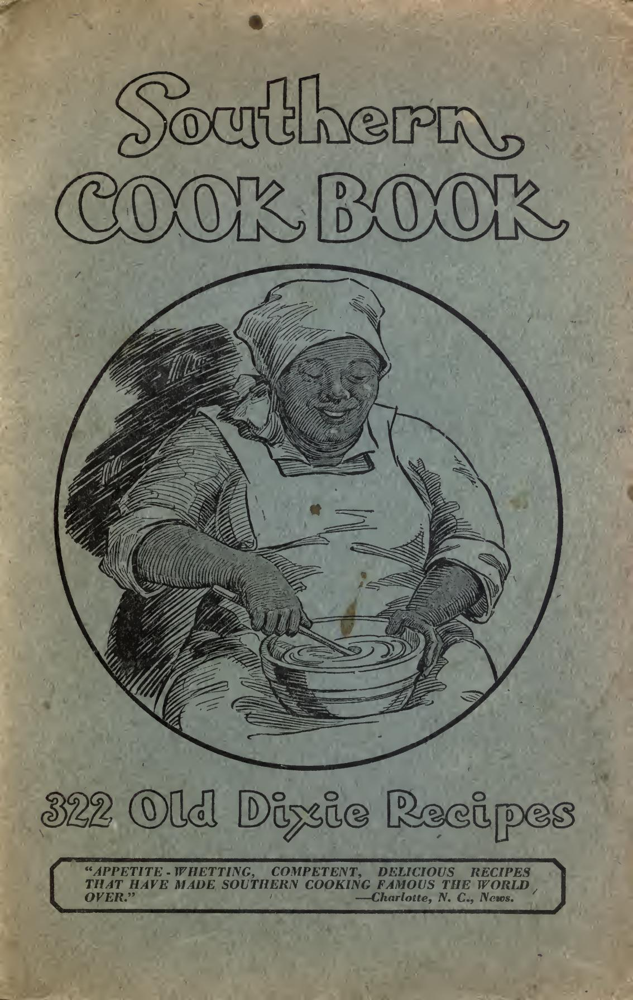

Recetas correctamente formadas en la página 1: 0
Recetas incorrectamente formadas en la página 1: 1
Procesando página 2


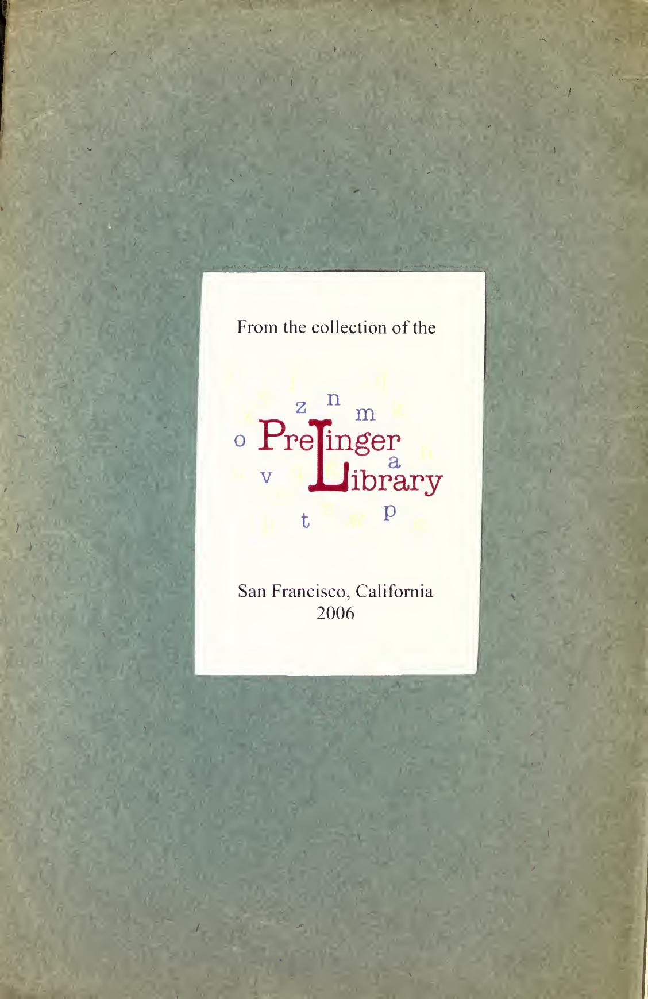

Recetas correctamente formadas en la página 2: 0
Recetas incorrectamente formadas en la página 2: 1
Procesando página 3


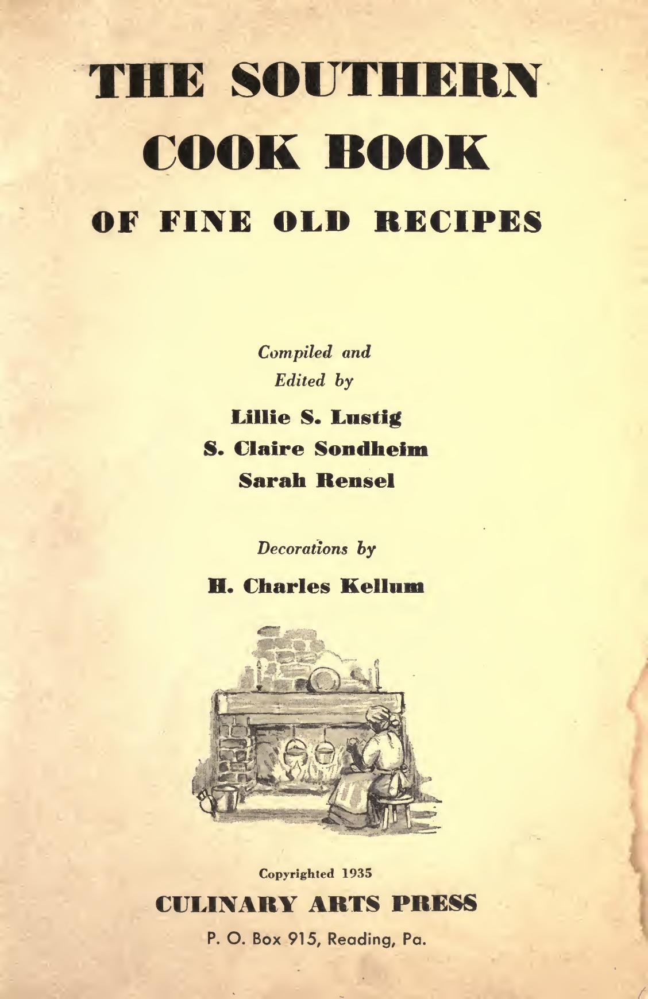

Recetas correctamente formadas en la página 3: 0
Recetas incorrectamente formadas en la página 3: 1
Procesando página 4


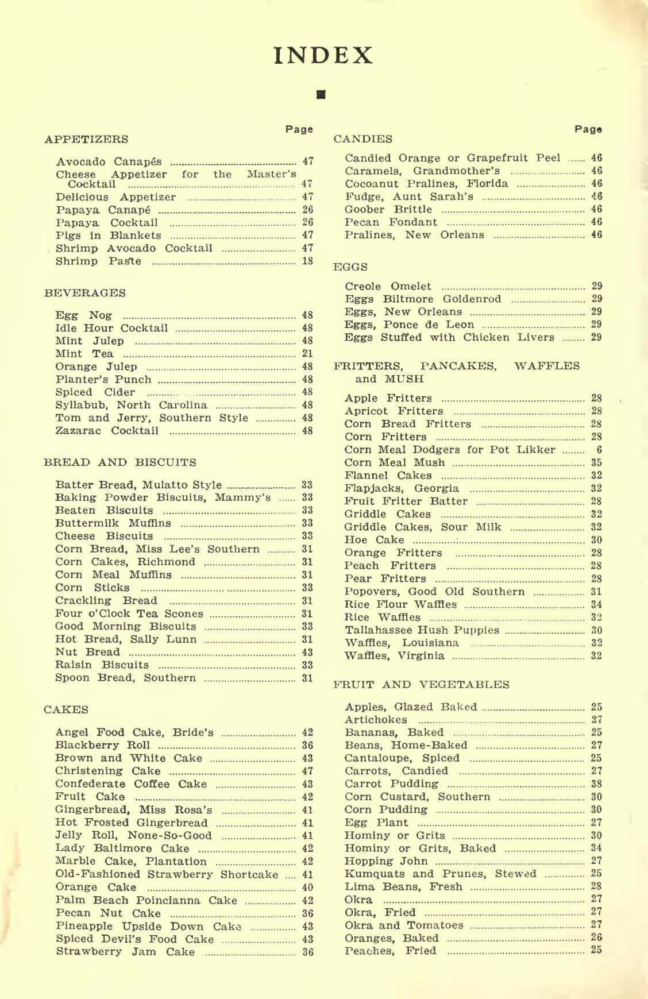

Recetas correctamente formadas en la página 4: 0
Recetas incorrectamente formadas en la página 4: 1
Procesando página 5


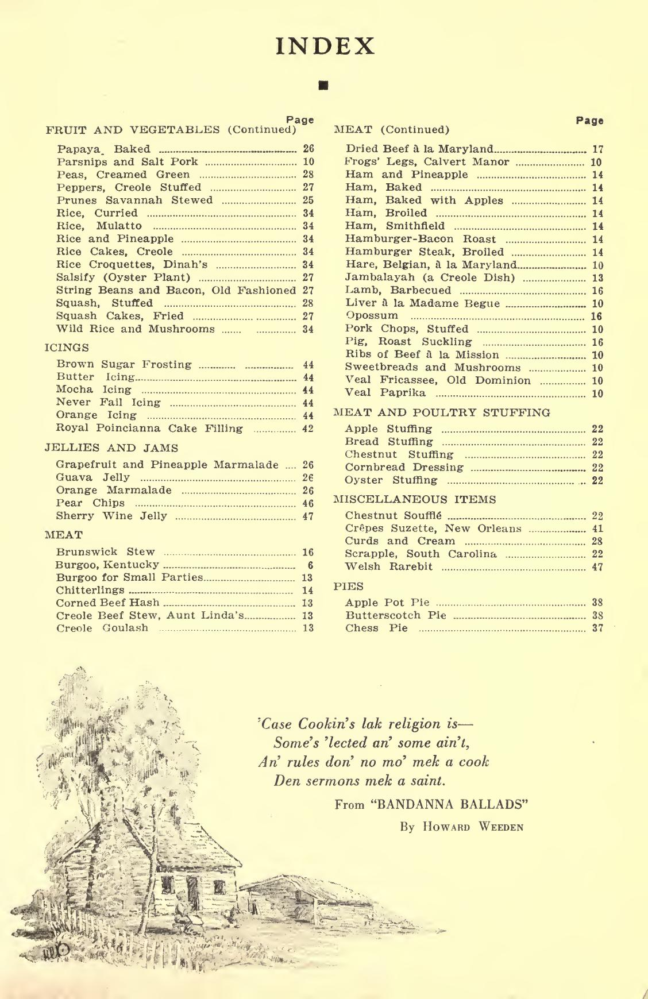

Recetas correctamente formadas en la página 5: 0
Recetas incorrectamente formadas en la página 5: 1
Procesando página 6


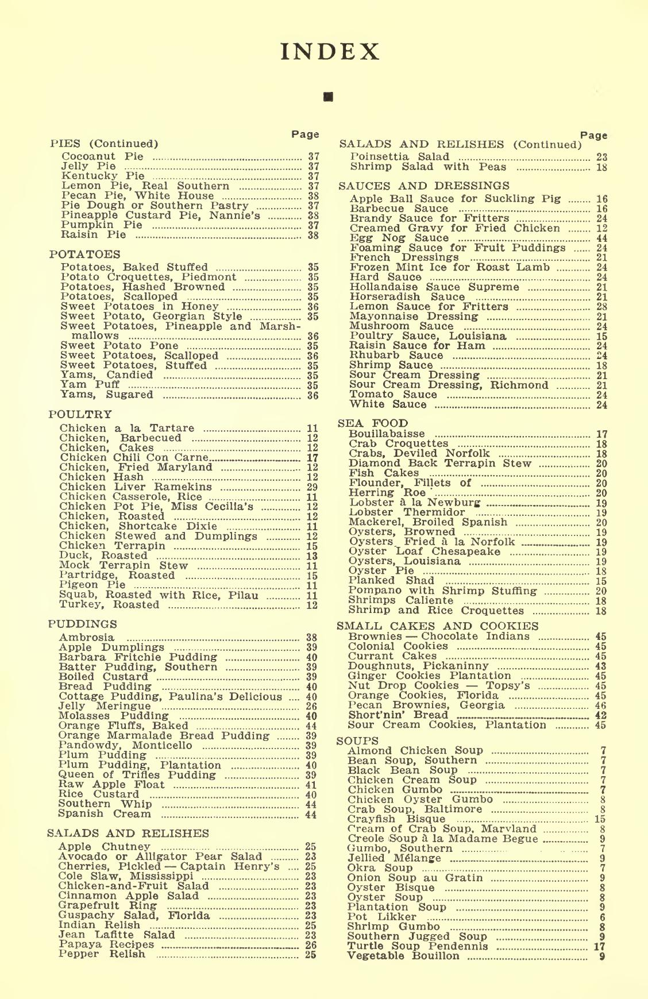

Recetas correctamente formadas en la página 6: 0
Recetas incorrectamente formadas en la página 6: 1
Procesando página 7


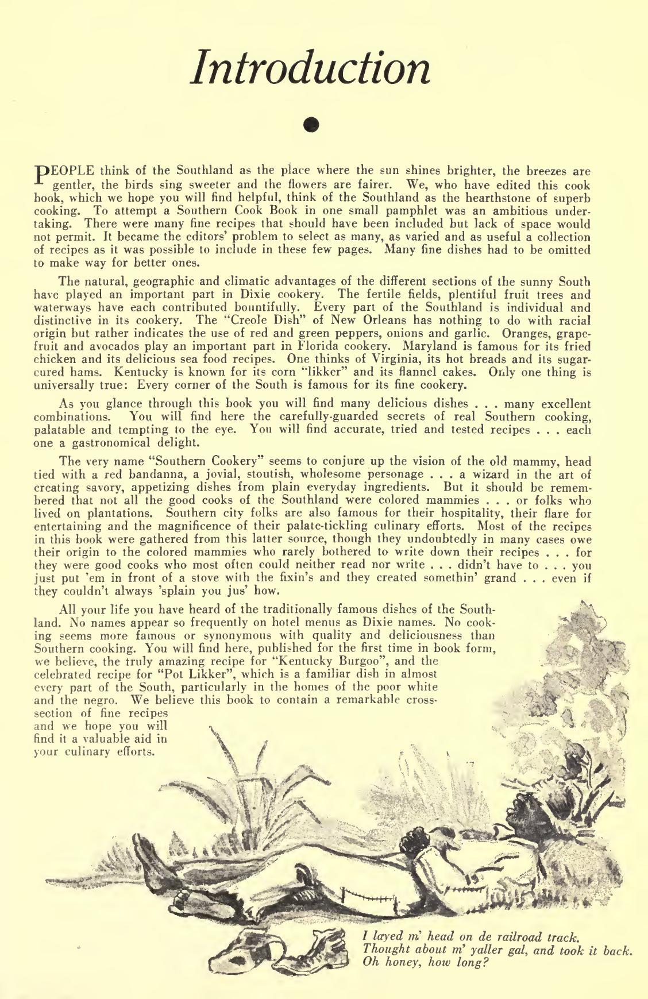

Recetas correctamente formadas en la página 7: 0
Recetas incorrectamente formadas en la página 7: 1
Procesando página 8


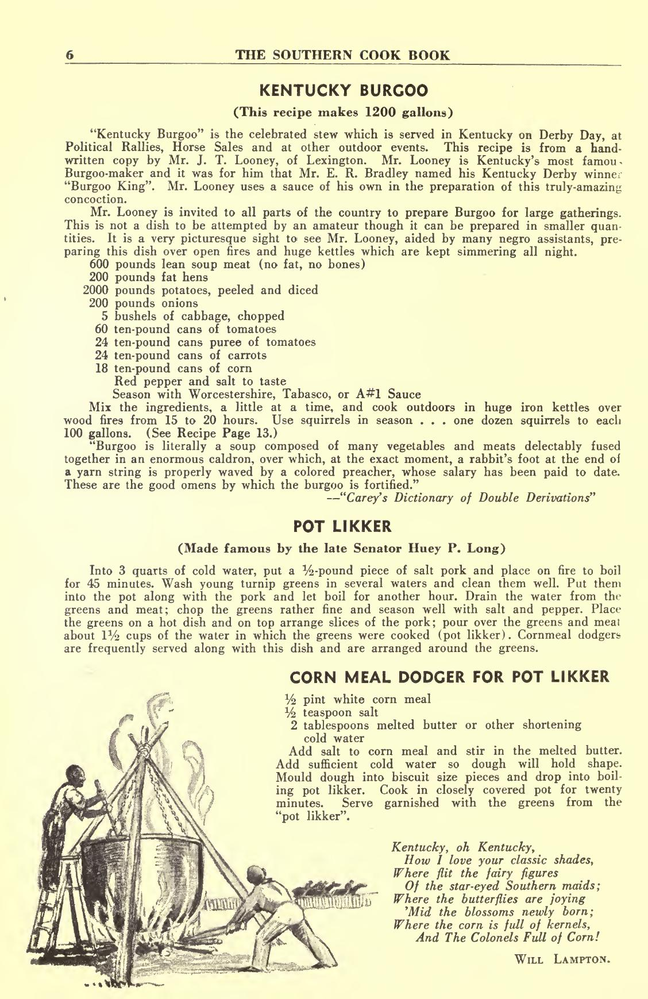

	Receta encontrada en la página 8: Kentucky Burgoo
	Receta encontrada en la página 8: Pot Likker
	Receta encontrada en la página 8: Corn Meal Dodger for Pot Likker
Recetas correctamente formadas en la página 8: 3
Recetas incorrectamente formadas en la página 8: 0
Procesando página 9


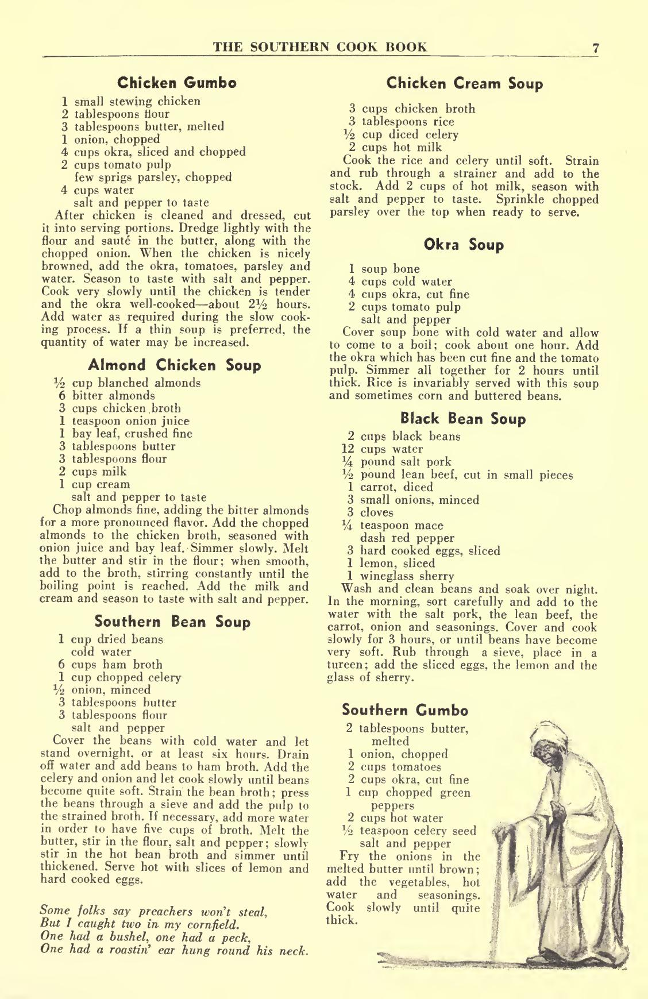

	Receta encontrada en la página 9: Gumbo de Pollo
	Receta encontrada en la página 9: Sopa Crema de Pollo
	Receta encontrada en la página 9: Sopa de Okra
	Receta encontrada en la página 9: Sopa de Pollo con Almendras
	Receta encontrada en la página 9: Sopa de Judías Negras
	Receta encontrada en la página 9: Sopa de Judías Sureña
	Receta encontrada en la página 9: Gumbo Sureño
Recetas correctamente formadas en la página 9: 7
Recetas incorrectamente formadas en la página 9: 0
Procesando página 10


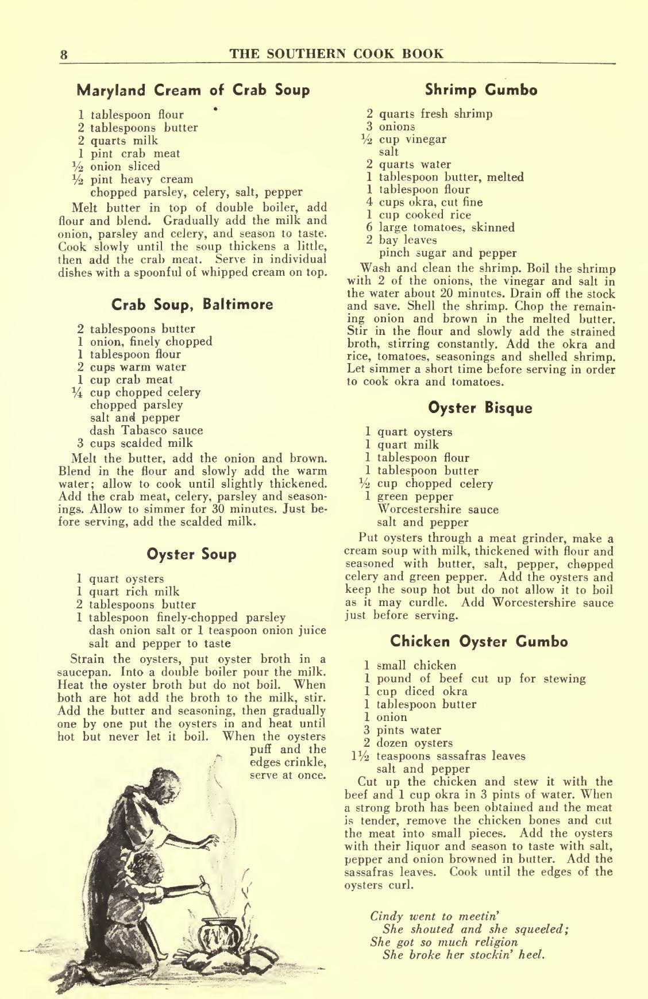

	Receta encontrada en la página 10: Sopa Crema de Cangrejo Maryland
	Receta encontrada en la página 10: Gumbo de Camarones
	Receta encontrada en la página 10: Sopa de Cangrejo Baltimore
	Receta encontrada en la página 10: Sopa Crema de Ostras
	Receta encontrada en la página 10: Sopa de Ostras
	Receta encontrada en la página 10: Gumbo de Pollo y Ostras
Recetas correctamente formadas en la página 10: 6
Recetas incorrectamente formadas en la página 10: 0
Procesando página 11


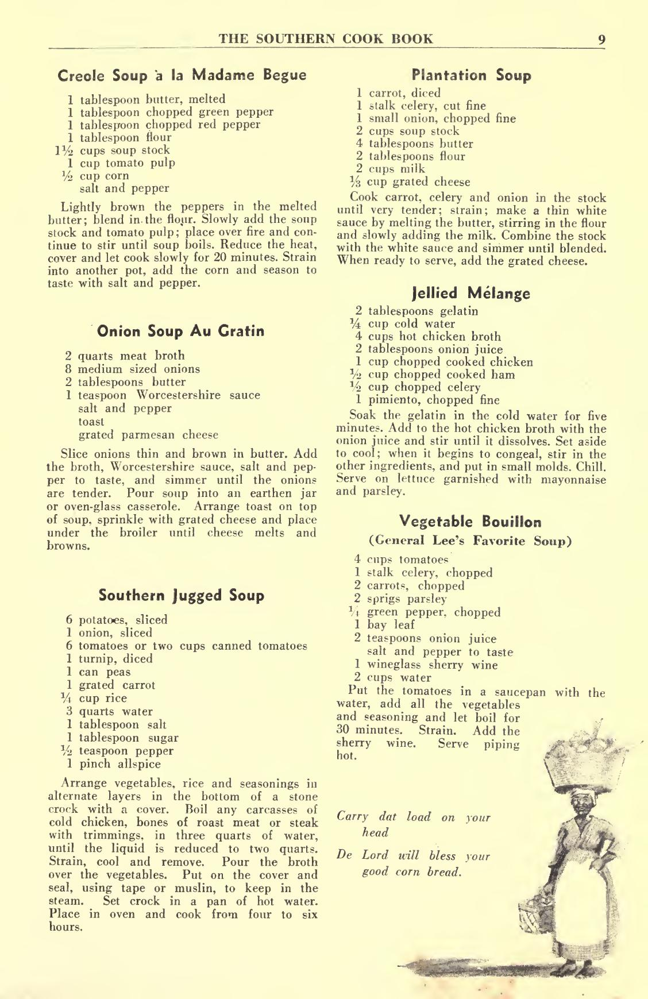

	Receta encontrada en la página 11: Sopa Criolla a la Madame Begue
	Receta encontrada en la página 11: Sopa Plantation
	Receta encontrada en la página 11: Sopa de Cebolla Gratinada
	Receta encontrada en la página 11: Mezcla Gelatinosa
	Receta encontrada en la página 11: Caldo de Verduras (Sopa Favorita del General Lee)
	Receta encontrada en la página 11: Sopa Sureña en Jarra
Recetas correctamente formadas en la página 11: 6
Recetas incorrectamente formadas en la página 11: 0
Procesando página 12


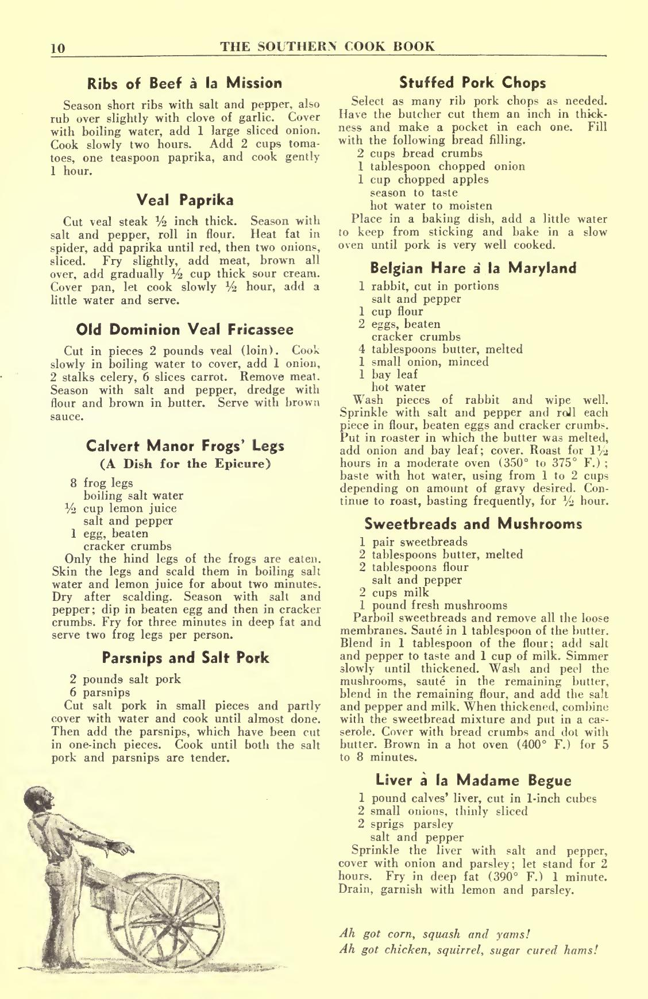

	Receta encontrada en la página 12: Costillas de Res a la Misión
	Receta encontrada en la página 12: Ternera a la Paprika
	Receta encontrada en la página 12: Fricasé de Ternera Old Dominion
	Receta encontrada en la página 12: Patas de Rana Calvert Manor
	Receta encontrada en la página 12: Chirivías y Cerdo Salado
	Receta encontrada en la página 12: Chuletas de Cerdo Rellenas
	Receta encontrada en la página 12: Liebre Belga a la Maryland
	Receta encontrada en la página 12: Mollejas y Champiñones
	Receta encontrada en la página 12: Hígado a la Madame Begue
Recetas correctamente formadas en la página 12: 9
Recetas incorrectamente formadas en la página 12: 0
Procesando página 13


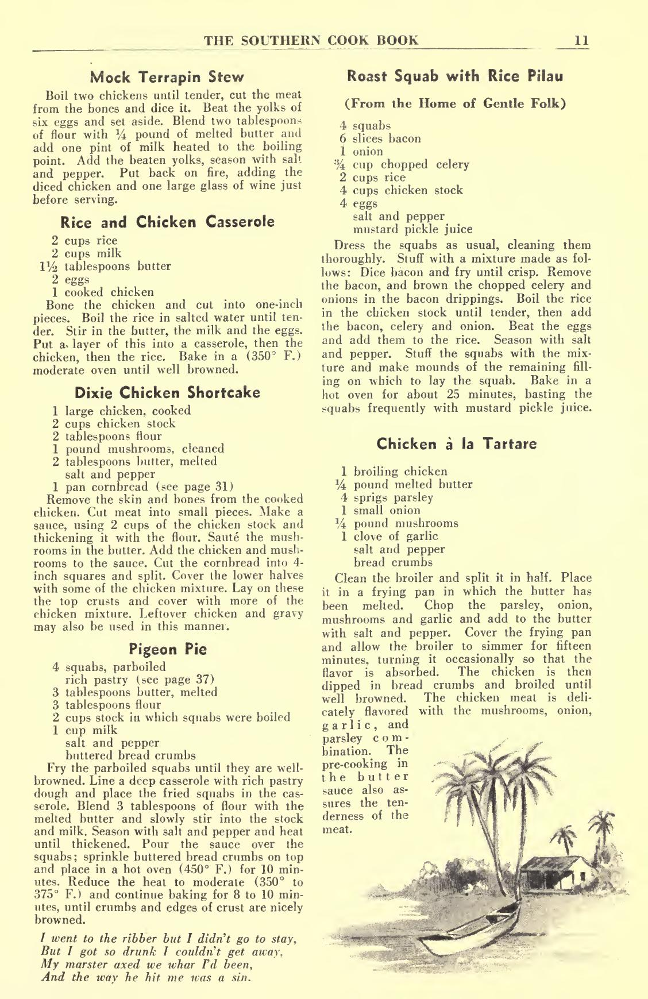

	Receta encontrada en la página 13: Estofado Falso de Tortuga
	Receta encontrada en la página 13: Cazuela de Arroz y Pollo
	Receta encontrada en la página 13: Pastel de Pollo Dixie
	Receta encontrada en la página 13: Pichón Asado con Arroz Pilaf
	Receta encontrada en la página 13: Pollo a la Tártara
	Receta encontrada en la página 13: Pastel de Pichón
Recetas correctamente formadas en la página 13: 6
Recetas incorrectamente formadas en la página 13: 0
Procesando página 14


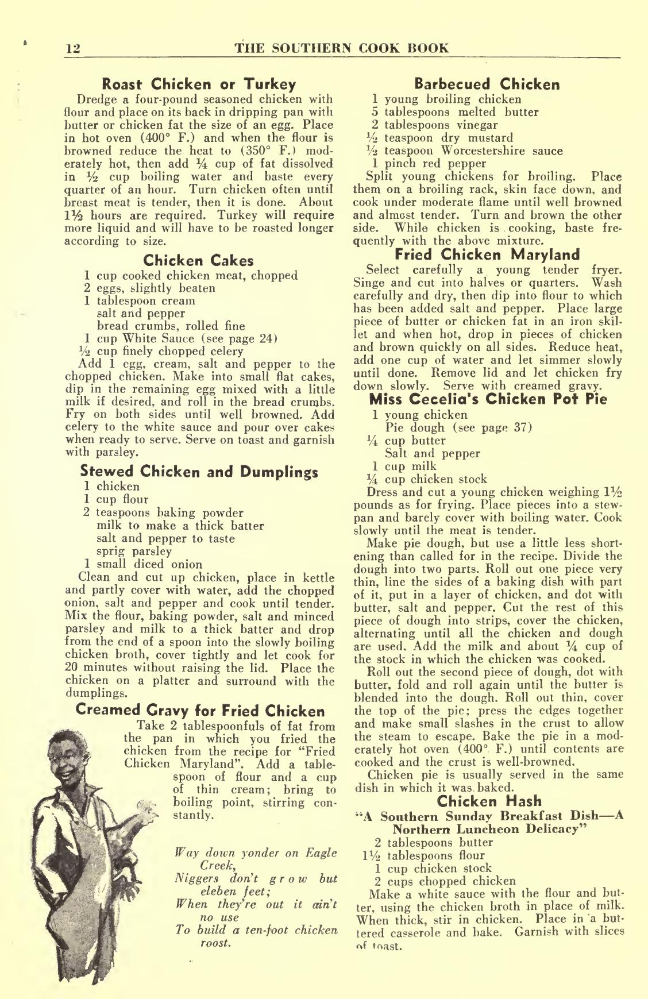

	Receta encontrada en la página 14: Pollo o Pavo Asado
	Receta encontrada en la página 14: Pollo a la Barbacoa
	Receta encontrada en la página 14: Tortitas de Pollo
	Receta encontrada en la página 14: Pollo Frito Maryland
	Receta encontrada en la página 14: Pollo Estofado con Dumplings
	Receta encontrada en la página 14: Pastel de Pollo de la Señorita Cecelia
	Receta encontrada en la página 14: Salsa Cremosa para Pollo Frito
	Receta encontrada en la página 14: Picadillo de Pollo
Recetas correctamente formadas en la página 14: 8
Recetas incorrectamente formadas en la página 14: 0
Procesando página 15


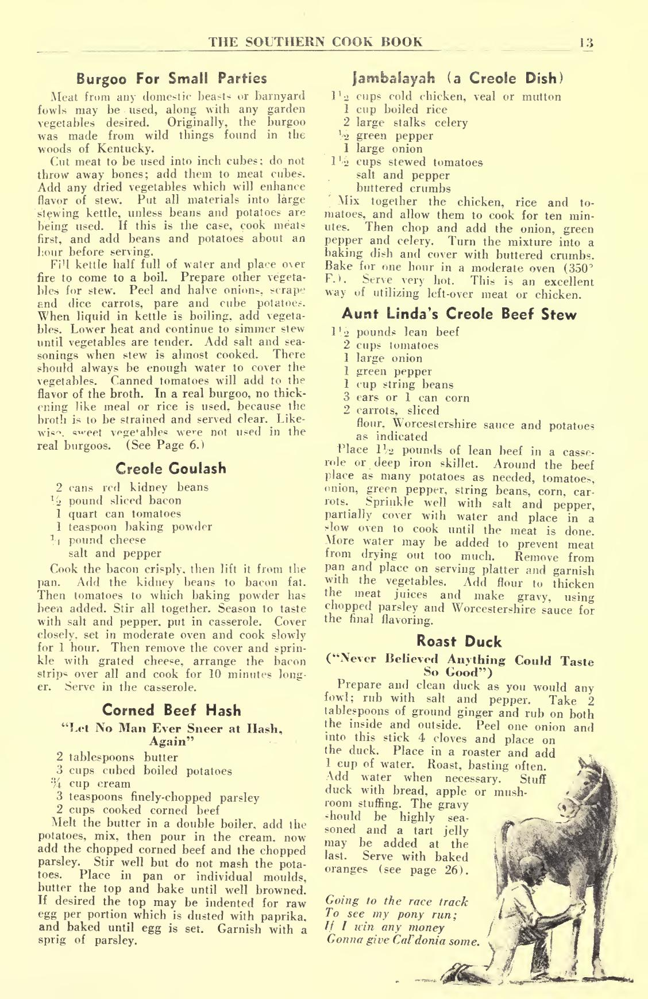

	Receta encontrada en la página 15: Burgoo Para Pequeñas Fiestas
	Receta encontrada en la página 15: Jambalaya (Un Plato Criollo)
	Receta encontrada en la página 15: Estofado de Res Criollo de la Tía Linda
	Receta encontrada en la página 15: Goulash Criollo
	Receta encontrada en la página 15: Picadillo de Carne en Salmuera "Que Ningún Hombre se Burle del Picadillo, Otra Vez"
	Receta encontrada en la página 15: Pato Asado ("Nunca Creí que Algo Pudiera Saber Tan Bien")
Recetas correctamente formadas en la página 15: 6
Recetas incorrectamente formadas en la página 15: 0
Procesando página 16


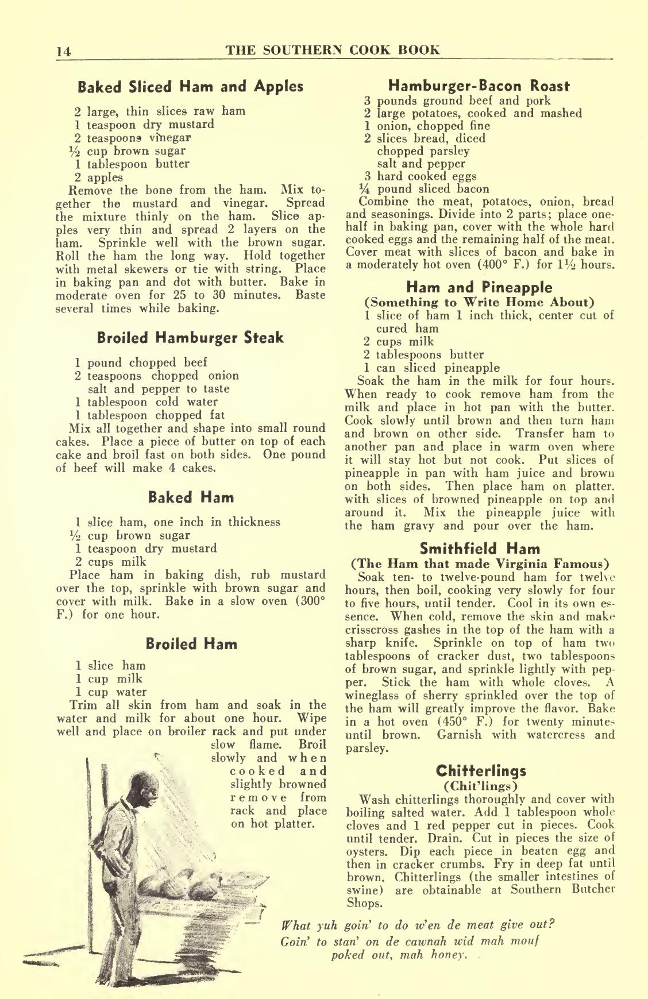

	Receta encontrada en la página 16: Jamón en Rodajas Horneado con Manzanas
	Receta encontrada en la página 16: Bistec de Hamburguesa a la Parrilla
	Receta encontrada en la página 16: Jamón Horneado
	Receta encontrada en la página 16: Jamón a la Parrilla
	Receta encontrada en la página 16: Asado de Hamburguesa y Tocino
	Receta encontrada en la página 16: Jamón y Piña
	Receta encontrada en la página 16: Jamón Smithfield
	Receta encontrada en la página 16: Chinchulines
Recetas correctamente formadas en la página 16: 8
Recetas incorrectamente formadas en la página 16: 0
Procesando página 17


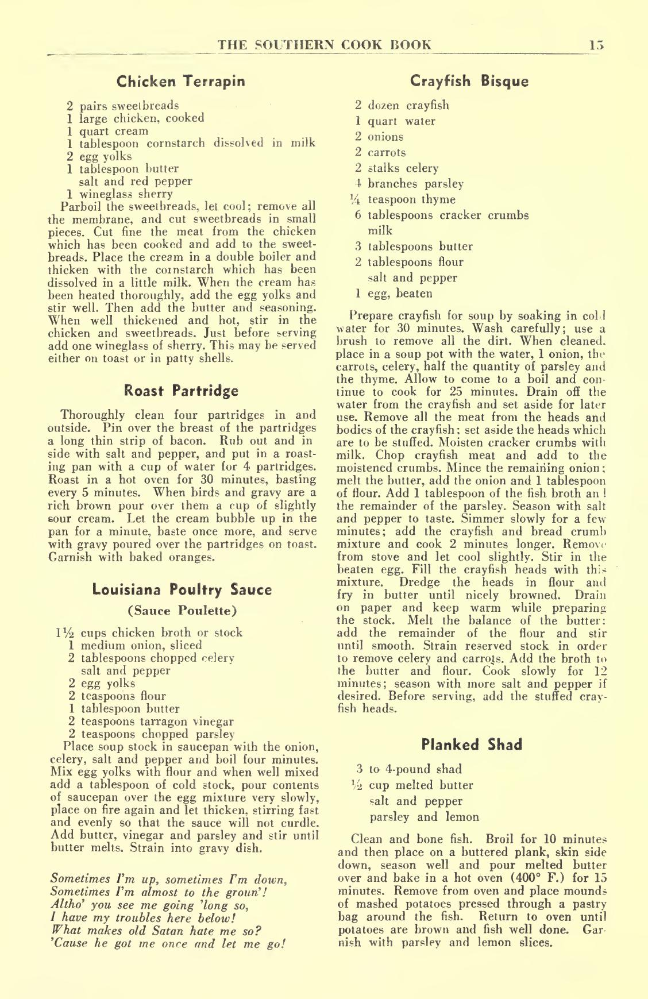

	Receta encontrada en la página 17: Terrapín de Pollo
	Receta encontrada en la página 17: Sopa de Cangrejo de Río
	Receta encontrada en la página 17: Perdiz Asada
	Receta encontrada en la página 17: Salsa de Ave Luisiana (Salsa Poulette)
	Receta encontrada en la página 17: Sábalo en Tabla
Recetas correctamente formadas en la página 17: 5
Recetas incorrectamente formadas en la página 17: 0
Procesando página 18


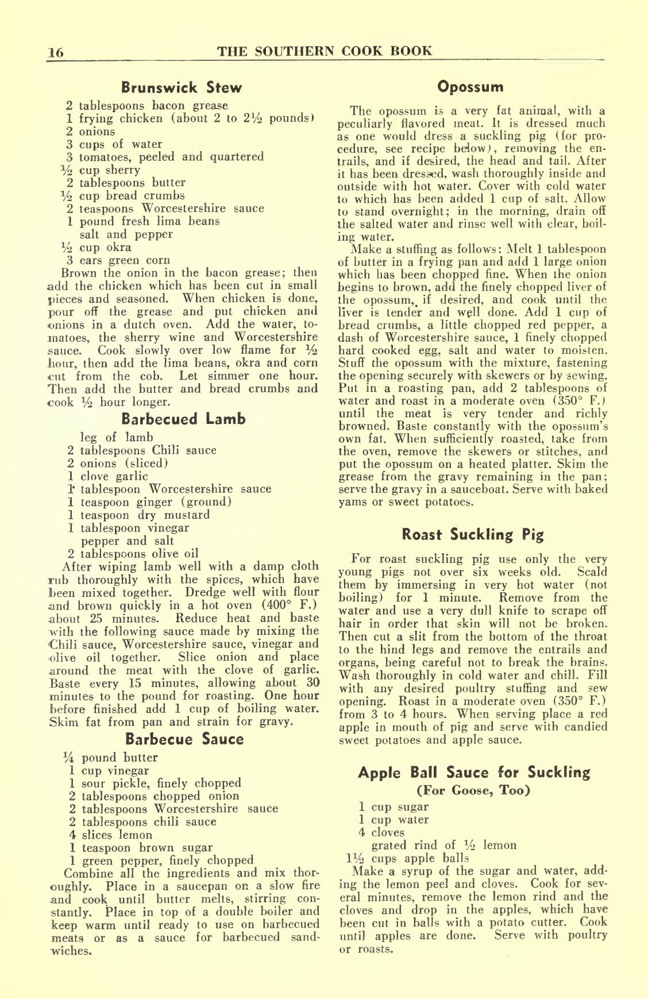

	Receta encontrada en la página 18: Estofado Brunswick
	Receta encontrada en la página 18: Zarigüeya
	Receta encontrada en la página 18: Cordero a la Barbacoa
	Receta encontrada en la página 18: Salsa Barbacoa
	Receta encontrada en la página 18: Cochinillo Asado
	Receta encontrada en la página 18: Salsa de Bolas de Manzana para Cochinillo (También para Ganso)
Recetas correctamente formadas en la página 18: 6
Recetas incorrectamente formadas en la página 18: 0
Procesando página 19


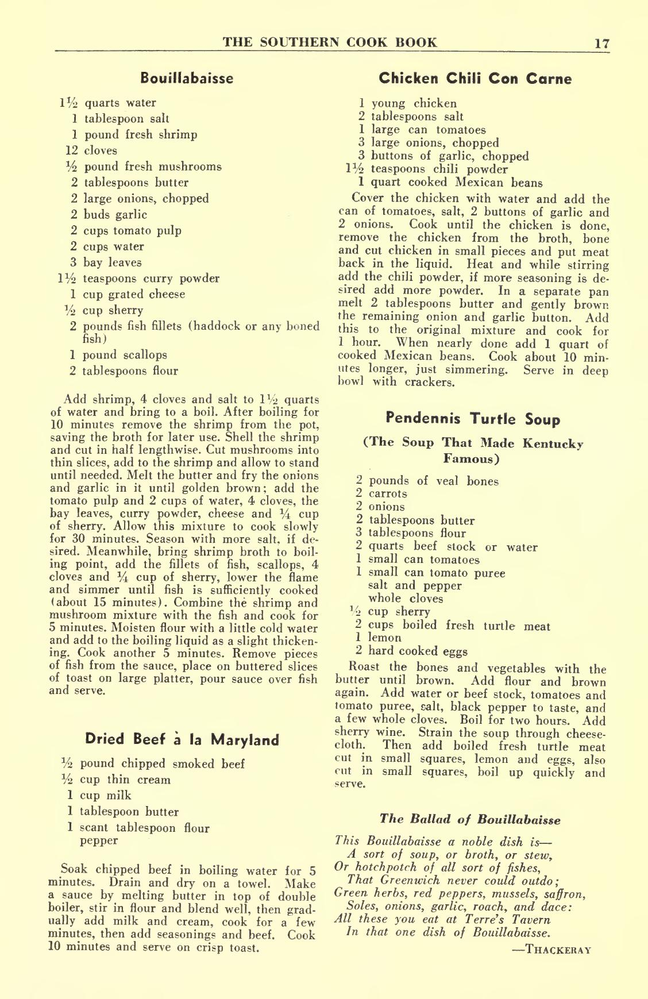

	Receta encontrada en la página 19: Bouillabaisse
	Receta encontrada en la página 19: Chile con Carne de Pollo
	Receta encontrada en la página 19: Sopa de Tortuga Pendennis
	Receta encontrada en la página 19: Carne Seca a la Maryland
Recetas correctamente formadas en la página 19: 4
Recetas incorrectamente formadas en la página 19: 0
Procesando página 20


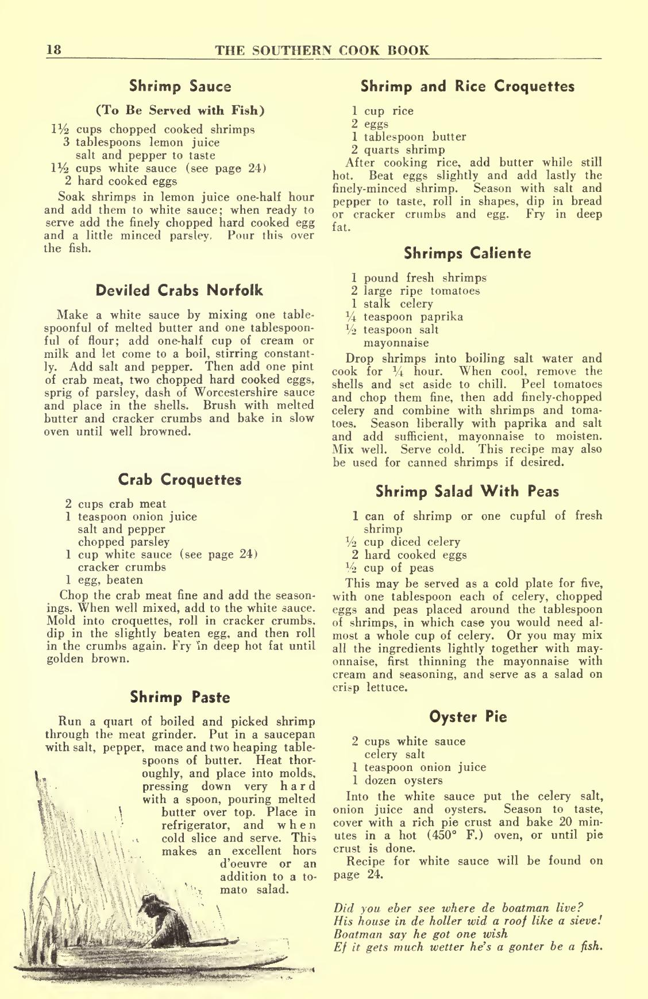

	Receta encontrada en la página 20: Salsa de Camarones (Para Servir con Pescado)
	Receta encontrada en la página 20: Croquetas de Camarones y Arroz
	Receta encontrada en la página 20: Cangrejos Endiablados Norfolk
	Receta encontrada en la página 20: Camarones Calientes
	Receta encontrada en la página 20: Croquetas de Cangrejo
	Receta encontrada en la página 20: Ensalada de Camarones con Guisantes
	Receta encontrada en la página 20: Pasta de Camarones
	Receta encontrada en la página 20: Pastel de Ostras
Recetas correctamente formadas en la página 20: 8
Recetas incorrectamente formadas en la página 20: 0
Procesando página 21


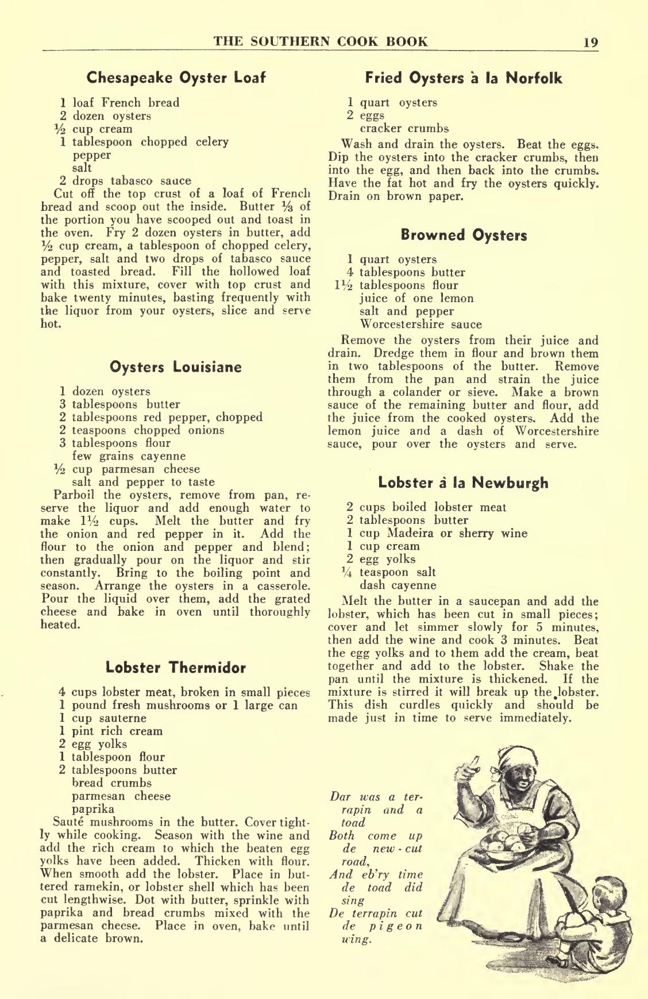

	Receta encontrada en la página 21: Pan de Ostras Chesapeake
	Receta encontrada en la página 21: Ostras Fritas a la Norfolk
	Receta encontrada en la página 21: Ostras Doradas
	Receta encontrada en la página 21: Ostras Louisiane
	Receta encontrada en la página 21: Langosta a la Newburgh
	Receta encontrada en la página 21: Langosta Thermidor
Recetas correctamente formadas en la página 21: 6
Recetas incorrectamente formadas en la página 21: 0
Procesando página 22


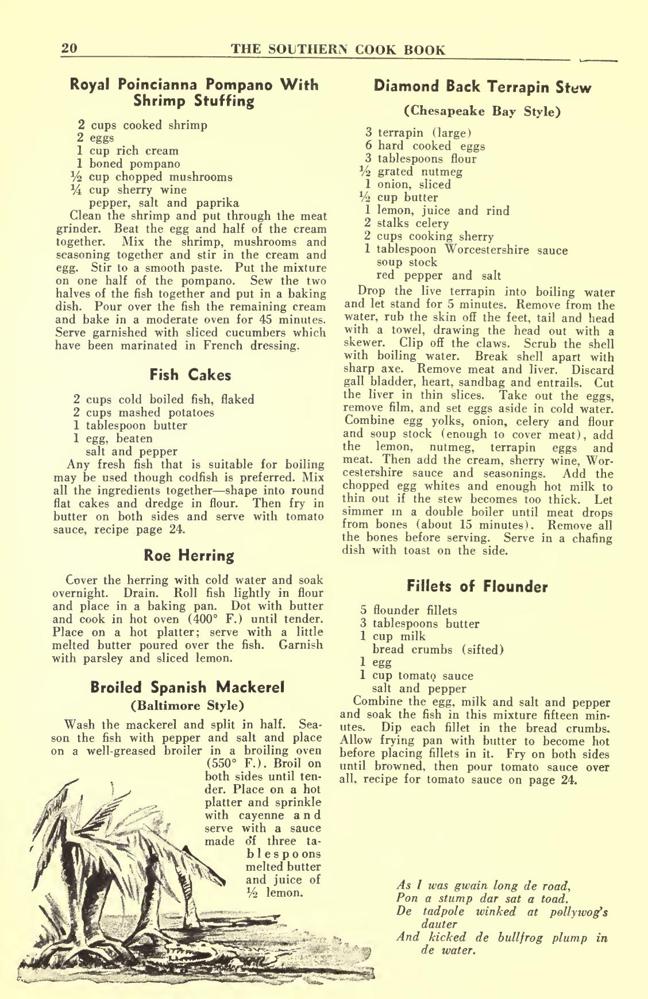

	Receta encontrada en la página 22: Pargo Real Poincianna Relleno de Camarones
	Receta encontrada en la página 22: Estofado de Tortuga Diamante (Estilo Bahía de Chesapeake)
	Receta encontrada en la página 22: Tortitas de Pescado
	Receta encontrada en la página 22: Arenque con Huevas
	Receta encontrada en la página 22: Filetes de Lenguado
	Receta encontrada en la página 22: Caballa Española Asada (Estilo Baltimore)
Recetas correctamente formadas en la página 22: 6
Recetas incorrectamente formadas en la página 22: 0
Procesando página 23


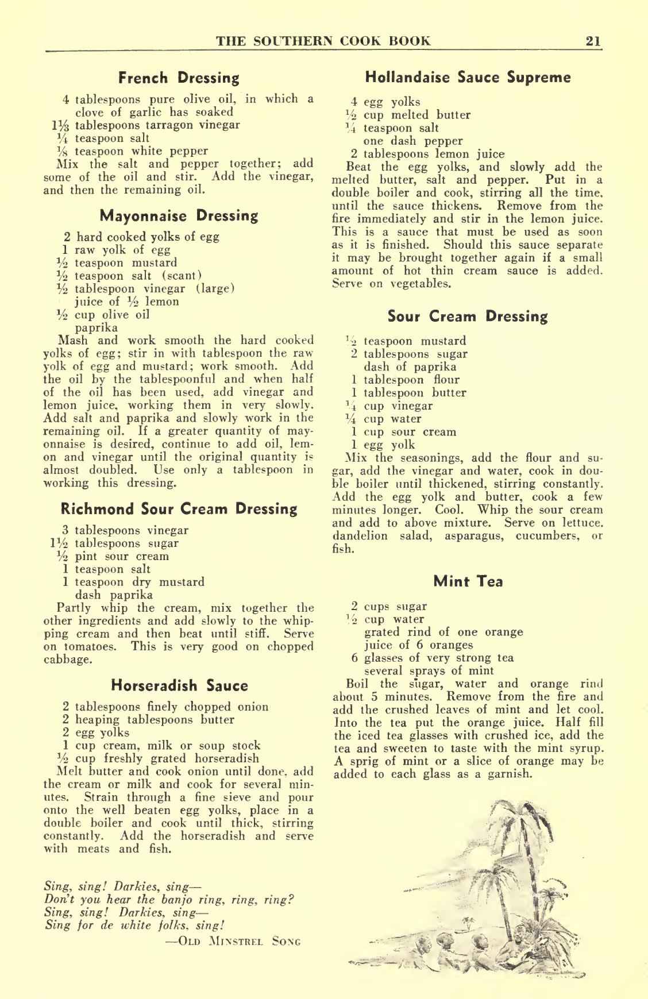

	Receta encontrada en la página 23: Aderezo Francés
	Receta encontrada en la página 23: Aderezo de Mayonesa
	Receta encontrada en la página 23: Aderezo de Crema Agria Richmond
	Receta encontrada en la página 23: Salsa de Rábano Picante
	Receta encontrada en la página 23: Salsa Holandesa Suprema
	Receta encontrada en la página 23: Aderezo de Crema Agria
	Receta encontrada en la página 23: Té de Menta
Recetas correctamente formadas en la página 23: 7
Recetas incorrectamente formadas en la página 23: 0
Procesando página 24


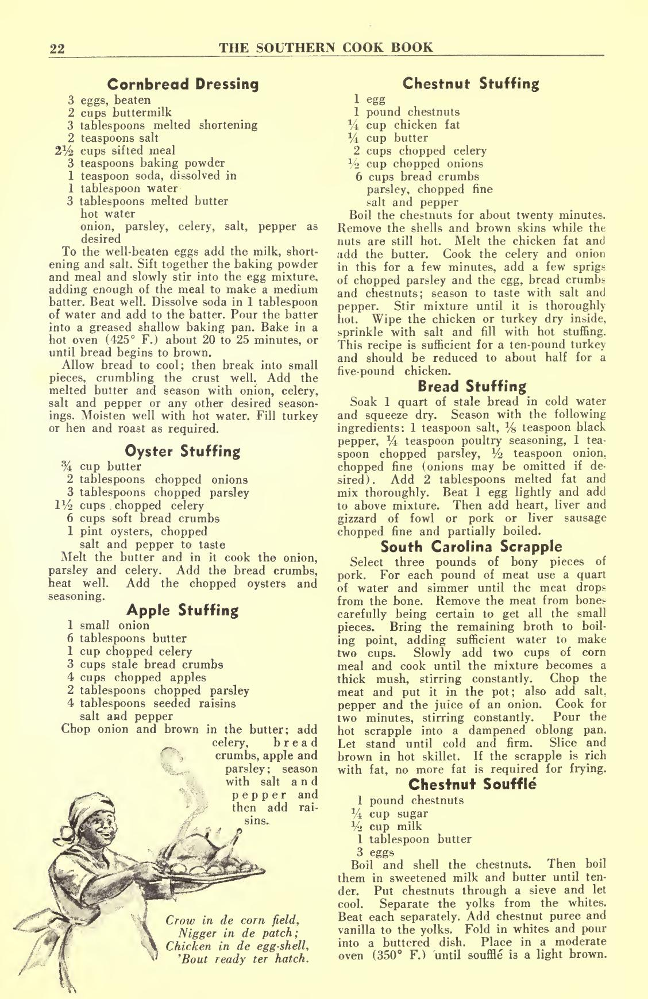

	Receta encontrada en la página 24: Aderezo de Pan de Maíz
	Receta encontrada en la página 24: Relleno de Castañas
	Receta encontrada en la página 24: Relleno de Ostras
	Receta encontrada en la página 24: Relleno de Pan
	Receta encontrada en la página 24: Relleno de Manzana
	Receta encontrada en la página 24: Scrapple de Carolina del Sur
	Receta encontrada en la página 24: Soufflé de Castañas
Recetas correctamente formadas en la página 24: 7
Recetas incorrectamente formadas en la página 24: 0
Procesando página 25


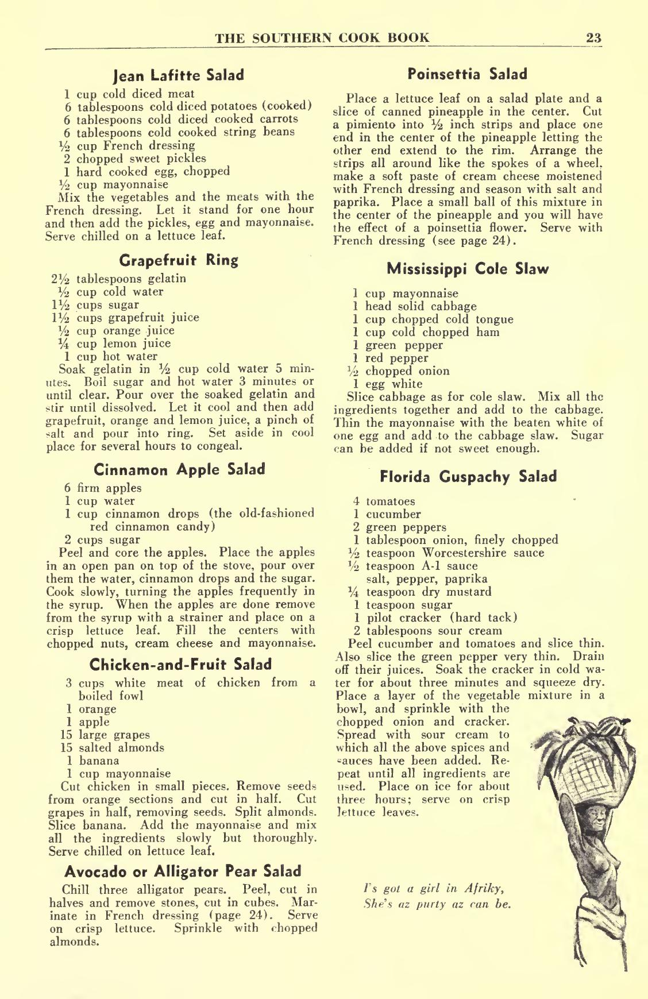

	Receta encontrada en la página 25: Ensalada Jean Lafitte
	Receta encontrada en la página 25: Ensalada Poinsettia
	Receta encontrada en la página 25: Anillo de Pomelo
	Receta encontrada en la página 25: Ensalada de Col Mississippi
	Receta encontrada en la página 25: Ensalada de Manzana con Canela
	Receta encontrada en la página 25: Ensalada Guspachy de Florida
	Receta encontrada en la página 25: Ensalada de Pollo y Frutas
	Receta encontrada en la página 25: Ensalada de Aguacate o Pera de Caimán
Recetas correctamente formadas en la página 25: 8
Recetas incorrectamente formadas en la página 25: 0
Procesando página 26


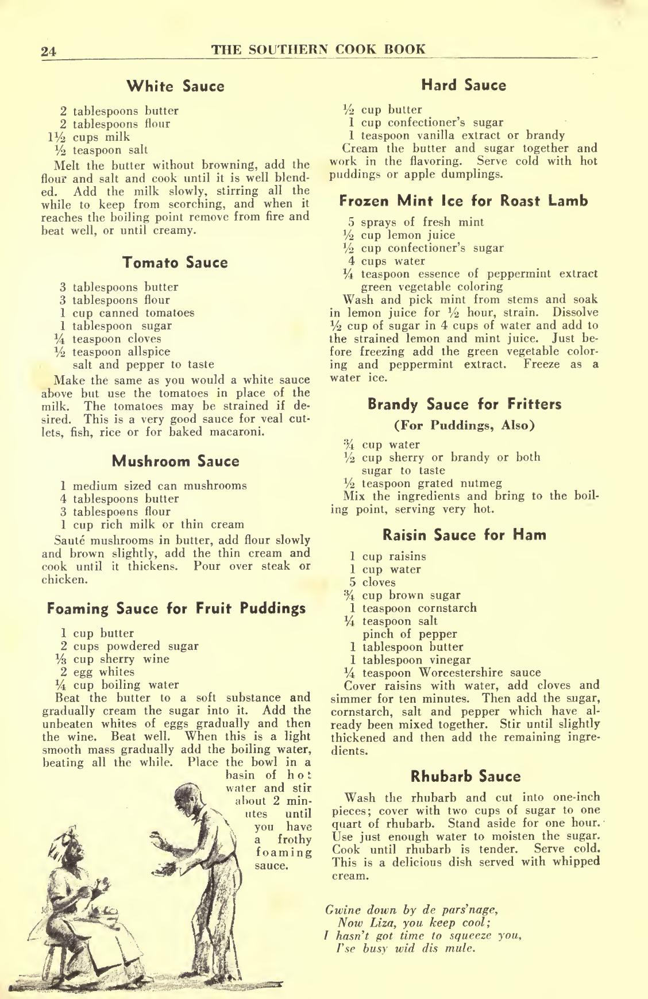

	Receta encontrada en la página 26: Salsa Blanca
	Receta encontrada en la página 26: Salsa Dura
	Receta encontrada en la página 26: Salsa de Tomate
	Receta encontrada en la página 26: Hielo de Menta Congelado para Cordero Asado
	Receta encontrada en la página 26: Salsa de Brandy para Buñuelos (También para Pudines)
	Receta encontrada en la página 26: Salsa de Champiñones
	Receta encontrada en la página 26: Salsa de Pasas para Jamón
	Receta encontrada en la página 26: Salsa Espumosa para Pudines de Frutas
	Receta encontrada en la página 26: Salsa de Ruibarbo
Recetas correctamente formadas en la página 26: 9
Recetas incorrectamente formadas en la página 26: 0
Procesando página 27


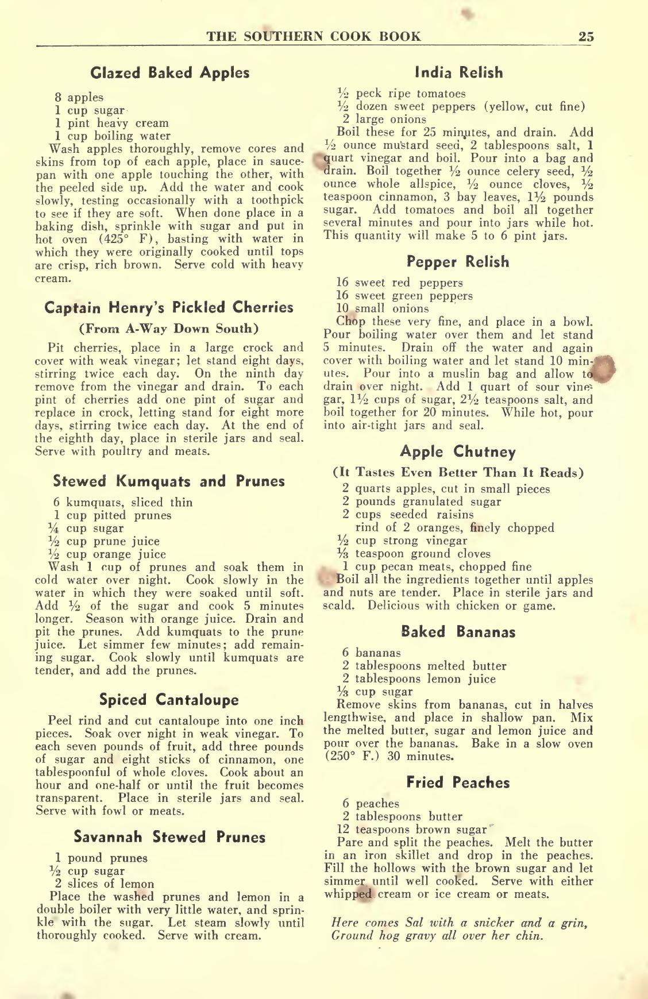

	Receta encontrada en la página 27: Manzanas Asadas Glaseadas
	Receta encontrada en la página 27: Relish India
	Receta encontrada en la página 27: Cerezas Encurtidas del Capitán Henry
	Receta encontrada en la página 27: Relish de Pimiento
	Receta encontrada en la página 27: Kumquats y Ciruelas Pasas Estofadas
	Receta encontrada en la página 27: Chutney de Manzana
	Receta encontrada en la página 27: Plátanos Horneados
	Receta encontrada en la página 27: Melón Especiado
	Receta encontrada en la página 27: Ciruelas Pasas Estofadas al Estilo Savannah
	Receta encontrada en la página 27: Melocotones Fritos
Recetas correctamente formadas en la página 27: 10
Recetas incorrectamente formadas en la página 27: 0
Procesando página 28


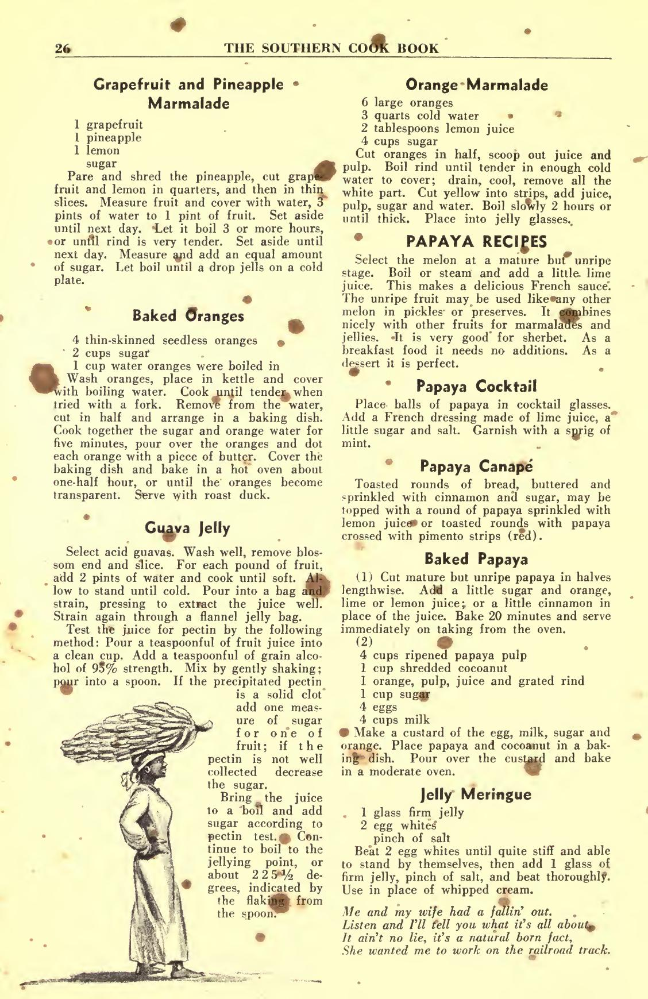

	Receta encontrada en la página 28: Mermelada de Pomelo y Piña
	Receta encontrada en la página 28: Mermelada de Naranja
	Receta encontrada en la página 28: Naranjas Asadas
	Receta encontrada en la página 28: Cóctel de Papaya
	Receta encontrada en la página 28: Canapé de Papaya
	Receta encontrada en la página 28: Jalea de Guayaba
	Receta encontrada en la página 28: Papaya Asada (Simple)
	Receta encontrada en la página 28: Papaya Asada (Natillas)
	Receta encontrada en la página 28: Merengue de Jalea
Recetas correctamente formadas en la página 28: 9
Recetas incorrectamente formadas en la página 28: 0
Procesando página 29


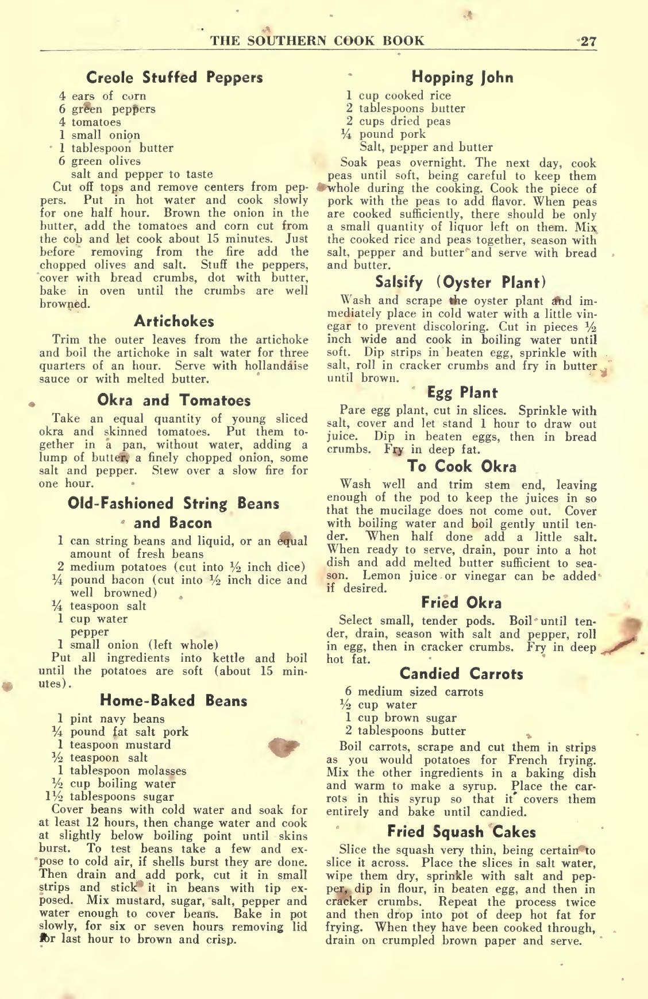

	Receta encontrada en la página 29: Pimientos Rellenos Criollos
	Receta encontrada en la página 29: Hopping John
	Receta encontrada en la página 29: Salsifí (Planta de Ostra)
	Receta encontrada en la página 29: Alcachofas
	Receta encontrada en la página 29: Berenjena
	Receta encontrada en la página 29: Okra y Tomates
	Receta encontrada en la página 29: Cómo Cocinar Okra
	Receta encontrada en la página 29: Judías Verdes y Tocino a la Antigua
	Receta encontrada en la página 29: Okra Frita
	Receta encontrada en la página 29: Judías Horneadas Caseras
	Receta encontrada en la página 29: Zanahorias Confitadas
	Receta encontrada en la página 29: Tortitas de Calabacín Fritas
Recetas correctamente formadas en la página 29: 12
Recetas incorrectamente formadas en la página 29: 0
Procesando página 30


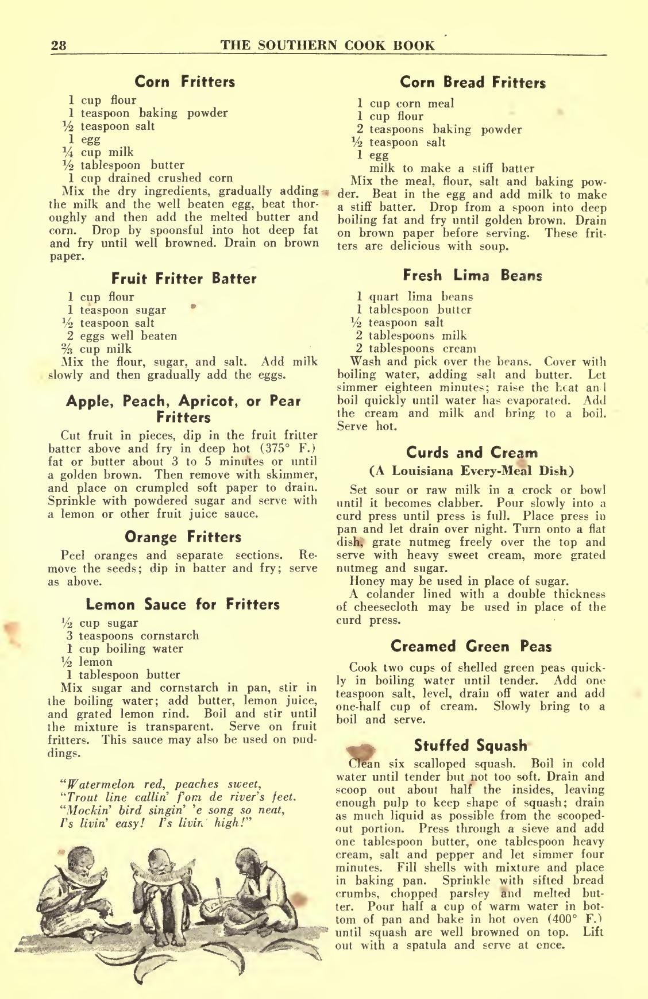

	Receta encontrada en la página 30: Buñuelos de Maíz
	Receta encontrada en la página 30: Buñuelos de Pan de Maíz
	Receta encontrada en la página 30: Masa para Buñuelos de Fruta
	Receta encontrada en la página 30: Buñuelos de Manzana, Durazno, Albaricoque o Pera
	Receta encontrada en la página 30: Buñuelos de Naranja
	Receta encontrada en la página 30: Salsa de Limón para Buñuelos
	Receta encontrada en la página 30: Habas Lima Frescas
	Receta encontrada en la página 30: Cuajada y Crema
	Receta encontrada en la página 30: Guisantes Verdes Cremosos
	Receta encontrada en la página 30: Calabaza Rellena
Recetas correctamente formadas en la página 30: 10
Recetas incorrectamente formadas en la página 30: 0
Procesando página 31


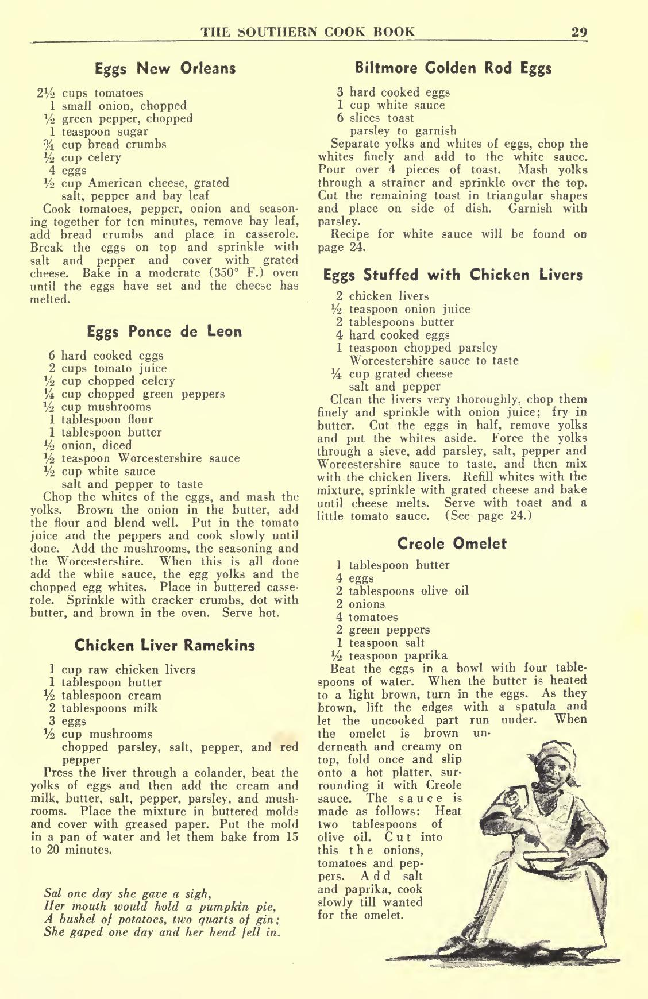

	Receta encontrada en la página 31: Huevos Nueva Orleans
	Receta encontrada en la página 31: Huevos Vara de Oro Biltmore
	Receta encontrada en la página 31: Huevos Rellenos con Hígados de Pollo
	Receta encontrada en la página 31: Huevos Ponce de León
	Receta encontrada en la página 31: Ramequines de Hígado de Pollo
	Receta encontrada en la página 31: Tortilla Criolla
Recetas correctamente formadas en la página 31: 6
Recetas incorrectamente formadas en la página 31: 0
Procesando página 32


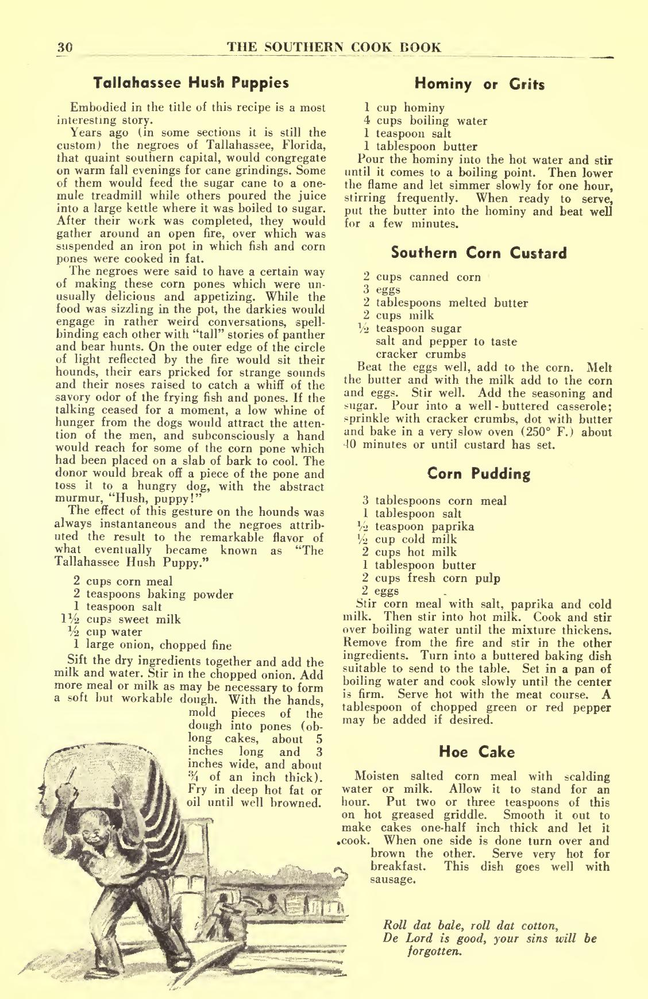

	Receta encontrada en la página 32: Tallahassee Hush Puppies
	Receta encontrada en la página 32: Sémola de Maíz o Grits
	Receta encontrada en la página 32: Flan de Maíz Sureño
	Receta encontrada en la página 32: Pudín de Maíz
	Receta encontrada en la página 32: Hoe Cake
Recetas correctamente formadas en la página 32: 5
Recetas incorrectamente formadas en la página 32: 0
Procesando página 33


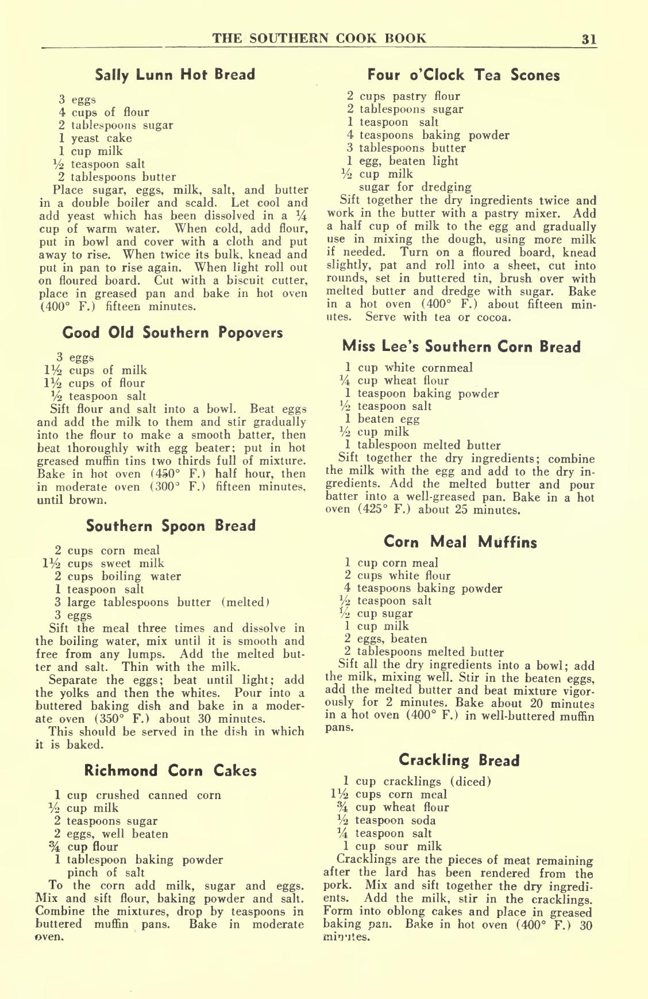

	Receta encontrada en la página 33: Pan Caliente Sally Lunn
	Receta encontrada en la página 33: Scones de Té de las Cuatro
	Receta encontrada en la página 33: Popovers Sureños Antiguos
	Receta encontrada en la página 33: Pan de Maíz Sureño de la Señorita Lee
	Receta encontrada en la página 33: Pan de Cuchara Sureño
	Receta encontrada en la página 33: Muffins de Harina de Maíz
	Receta encontrada en la página 33: Pasteles de Maíz de Richmond
	Receta encontrada en la página 33: Pan de Chicharrones
Recetas correctamente formadas en la página 33: 8
Recetas incorrectamente formadas en la página 33: 0
Procesando página 34


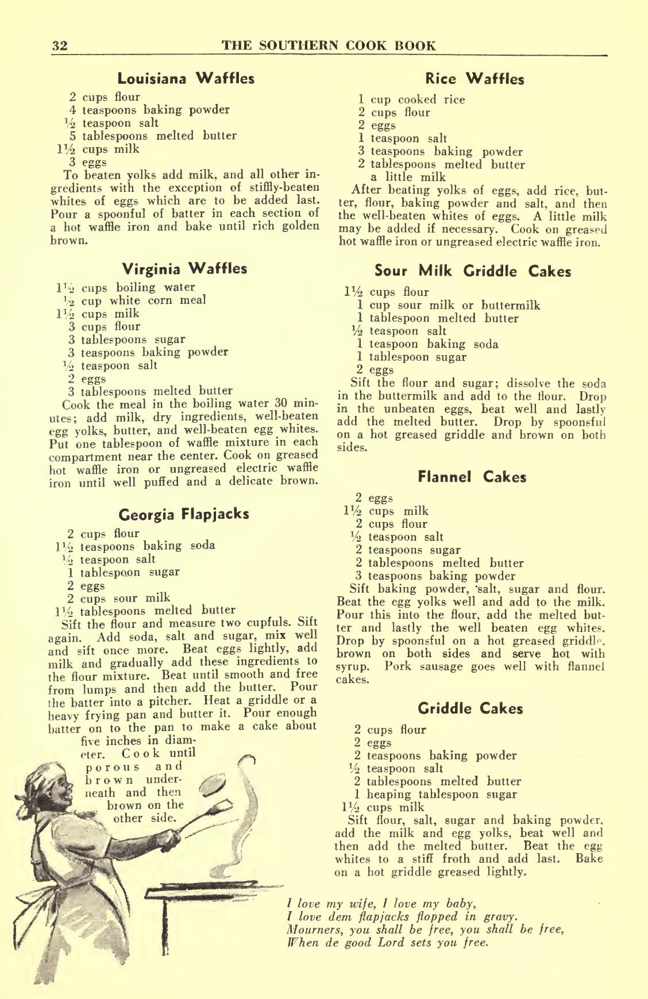

	Receta encontrada en la página 34: Waffles de Luisiana
	Receta encontrada en la página 34: Waffles de Arroz
	Receta encontrada en la página 34: Waffles de Virginia
	Receta encontrada en la página 34: Tortitas de Leche Agria
	Receta encontrada en la página 34: Tortitas de Franela
	Receta encontrada en la página 34: Tortitas de Georgia
	Receta encontrada en la página 34: Tortitas de Plancha
Recetas correctamente formadas en la página 34: 7
Recetas incorrectamente formadas en la página 34: 0
Procesando página 35


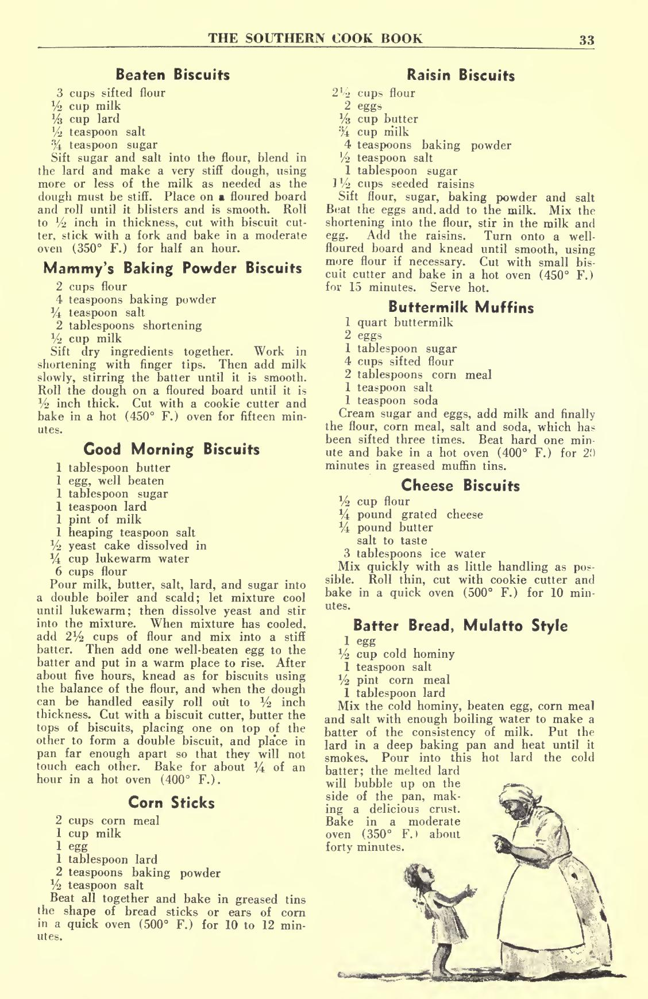

	Receta encontrada en la página 35: Bizcochos Batidos
	Receta encontrada en la página 35: Bizcochos de Polvo de Hornear de Mammy
	Receta encontrada en la página 35: Bizcochos de Buenos Días
	Receta encontrada en la página 35: Bizcochos de Pasas
	Receta encontrada en la página 35: Muffins de Suero de Mantequilla
	Receta encontrada en la página 35: Bizcochos de Queso
	Receta encontrada en la página 35: Pan de Masa, Estilo Mulato
	Receta encontrada en la página 35: Palitos de Maíz
Recetas correctamente formadas en la página 35: 8
Recetas incorrectamente formadas en la página 35: 0
Procesando página 36


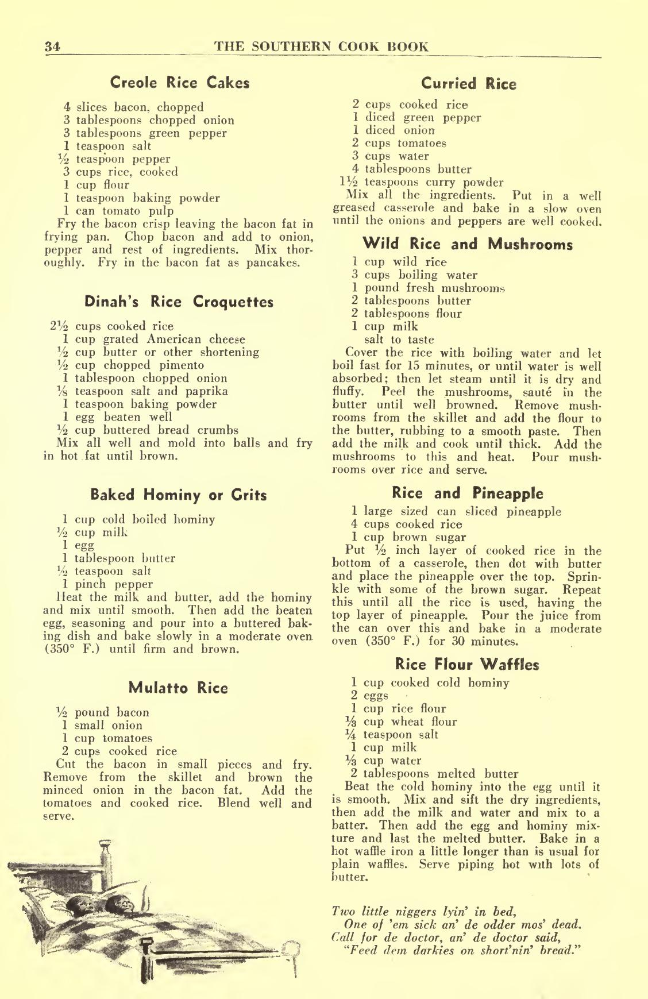

	Receta encontrada en la página 36: Pasteles de Arroz Criollos
	Receta encontrada en la página 36: Croquetas de Arroz de Dinah
	Receta encontrada en la página 36: Hominy o Grits Horneados
	Receta encontrada en la página 36: Arroz Mulato
	Receta encontrada en la página 36: Arroz al Curry
	Receta encontrada en la página 36: Arroz Salvaje y Champiñones
	Receta encontrada en la página 36: Arroz y Piña
	Receta encontrada en la página 36: Gofres de Harina de Arroz
Recetas correctamente formadas en la página 36: 8
Recetas incorrectamente formadas en la página 36: 0
Procesando página 37


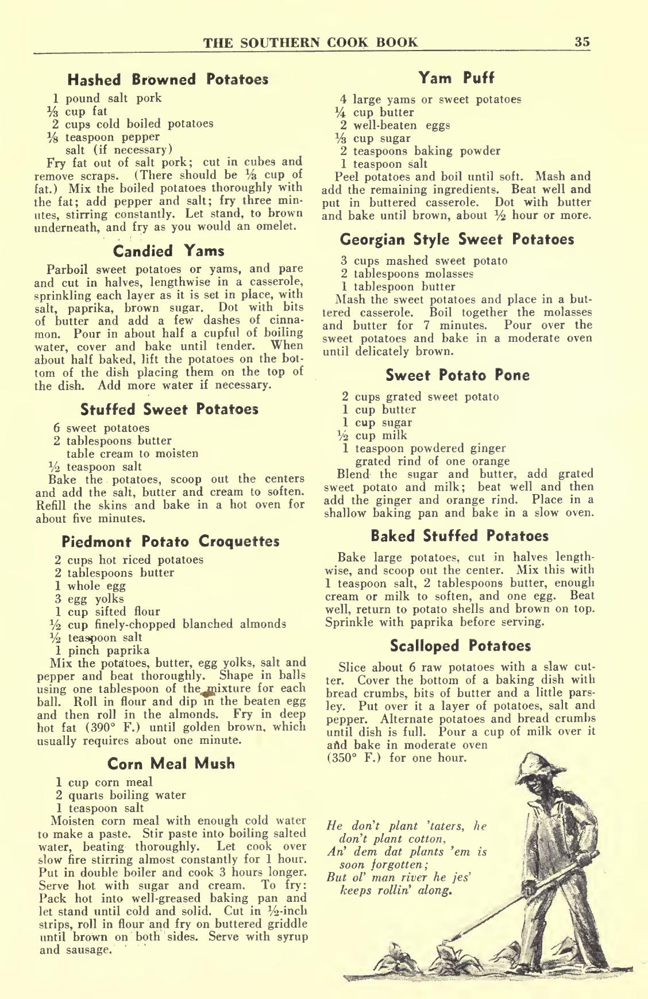

	Receta encontrada en la página 37: Patatas Hash Brown
	Receta encontrada en la página 37: Ñames Confitados
	Receta encontrada en la página 37: Batatas Rellenas
	Receta encontrada en la página 37: Croquetas de Patata Piedmont
	Receta encontrada en la página 37: Gachas de Harina de Maíz
	Receta encontrada en la página 37: Soufflé de Ñame
	Receta encontrada en la página 37: Batatas al Estilo Georgiano
	Receta encontrada en la página 37: Pone de Batata
	Receta encontrada en la página 37: Patatas Rellenas al Horno
	Receta encontrada en la página 37: Patatas Gratinadas
Recetas correctamente formadas en la página 37: 10
Recetas incorrectamente formadas en la página 37: 0
Procesando página 38


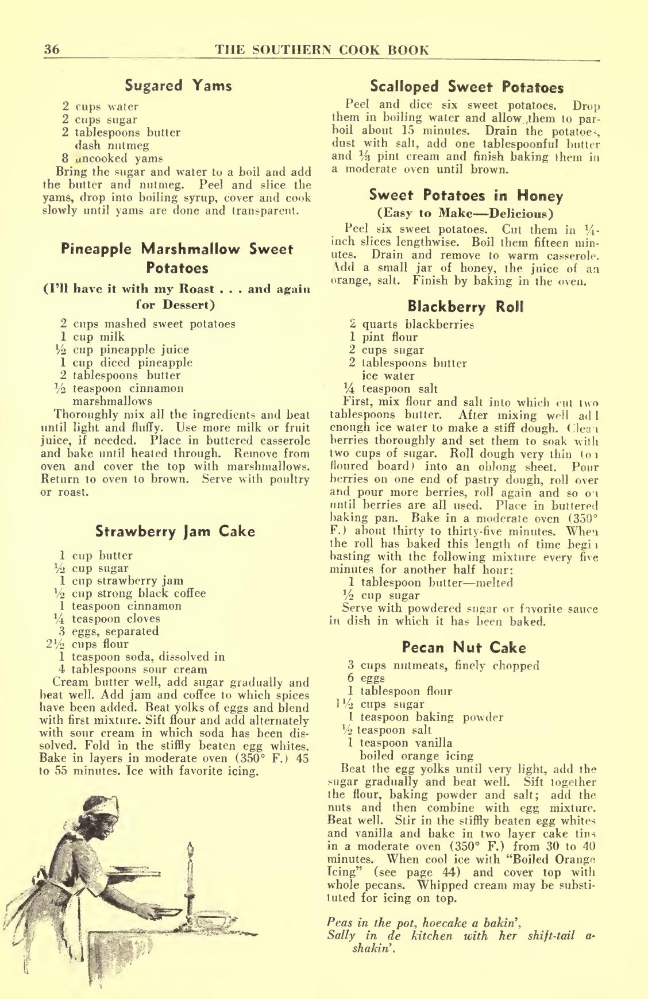

	Receta encontrada en la página 38: Ñames Azucarados
	Receta encontrada en la página 38: Batatas Gratinadas
	Receta encontrada en la página 38: Batatas con Miel
	Receta encontrada en la página 38: Batatas con Piña y Malvaviscos
	Receta encontrada en la página 38: Rollo de Moras
	Receta encontrada en la página 38: Pastel de Mermelada de Fresa
	Receta encontrada en la página 38: Pastel de Nueces Pecanas
Recetas correctamente formadas en la página 38: 7
Recetas incorrectamente formadas en la página 38: 0
Procesando página 39


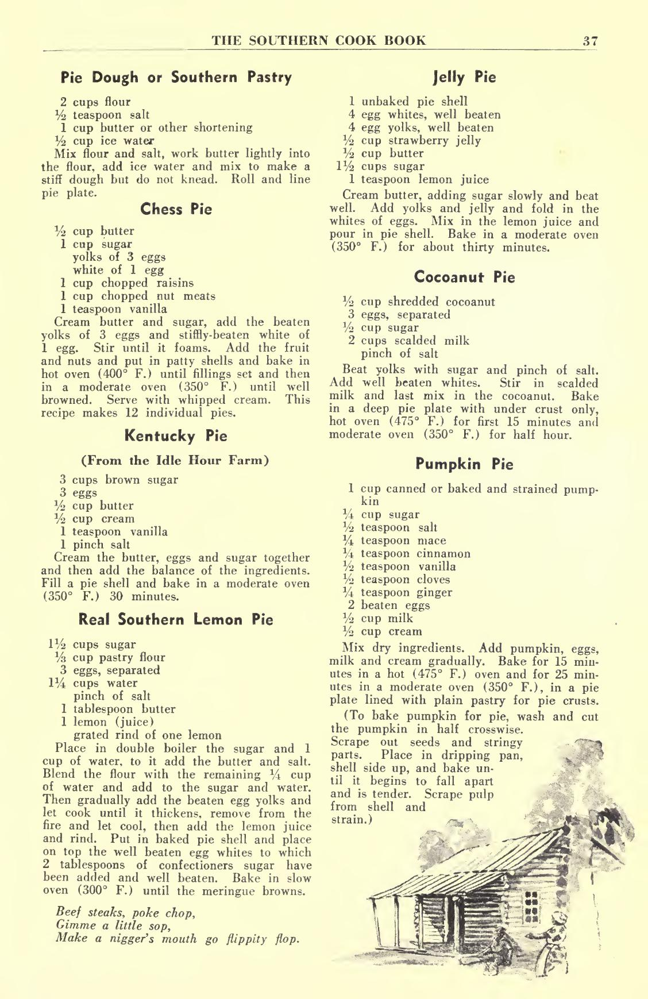

	Receta encontrada en la página 39: Masa para Pastel o Pastelería Sureña
	Receta encontrada en la página 39: Pastel de Jalea
	Receta encontrada en la página 39: Pastel de Ajedrez
	Receta encontrada en la página 39: Pastel de Coco
	Receta encontrada en la página 39: Pastel Kentucky
	Receta encontrada en la página 39: Auténtico Pastel de Limón Sureño
	Receta encontrada en la página 39: Pastel de Calabaza
Recetas correctamente formadas en la página 39: 7
Recetas incorrectamente formadas en la página 39: 0
Procesando página 40


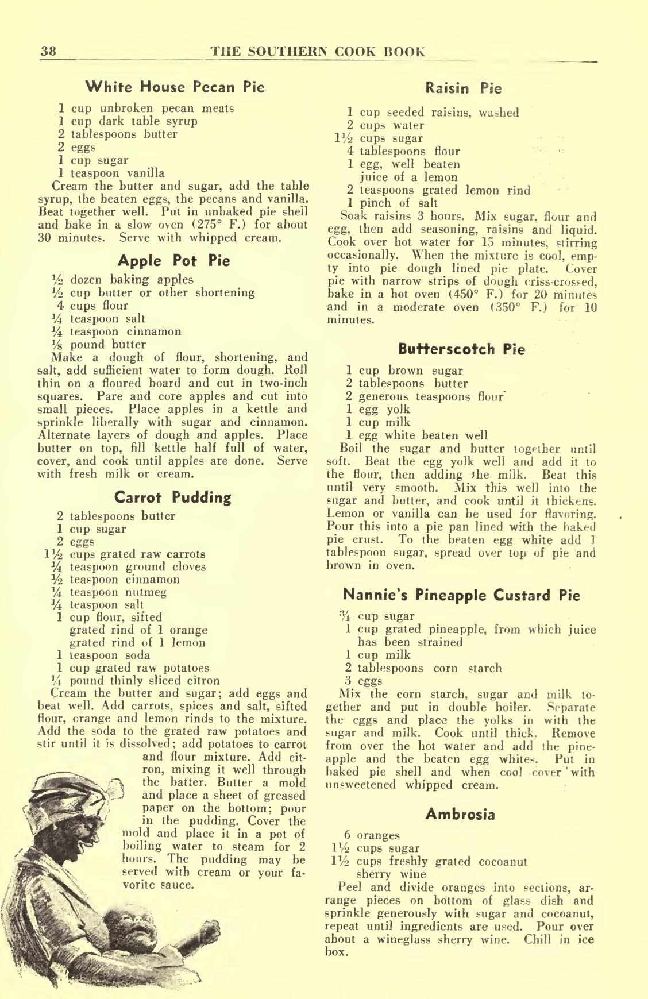

	Receta encontrada en la página 40: Pastel de Pecanas de la Casa Blanca
	Receta encontrada en la página 40: Pastel de Manzana en Olla
	Receta encontrada en la página 40: Pudín de Zanahoria
	Receta encontrada en la página 40: Pastel de Pasas
	Receta encontrada en la página 40: Pastel de Caramelo
	Receta encontrada en la página 40: Pastel de Natillas de Piña de Nannie
	Receta encontrada en la página 40: Ambrosía
Recetas correctamente formadas en la página 40: 7
Recetas incorrectamente formadas en la página 40: 0
Procesando página 41


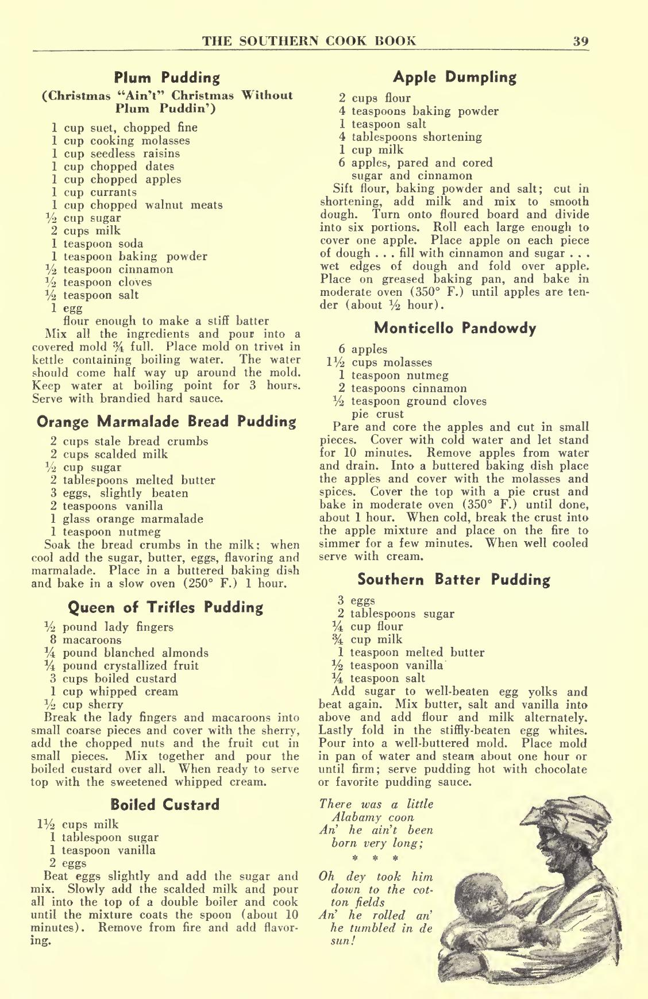

	Receta encontrada en la página 41: Plum Pudding (Christmas "Ain't" Christmas Without Plum Puddin')
	Receta encontrada en la página 41: Apple Dumpling
	Receta encontrada en la página 41: Monticello Pandowdy
	Receta encontrada en la página 41: Orange Marmalade Bread Pudding
	Receta encontrada en la página 41: Queen of Trifles Pudding
	Receta encontrada en la página 41: Southern Batter Pudding
	Receta encontrada en la página 41: Boiled Custard
Recetas correctamente formadas en la página 41: 7
Recetas incorrectamente formadas en la página 41: 0
Procesando página 42


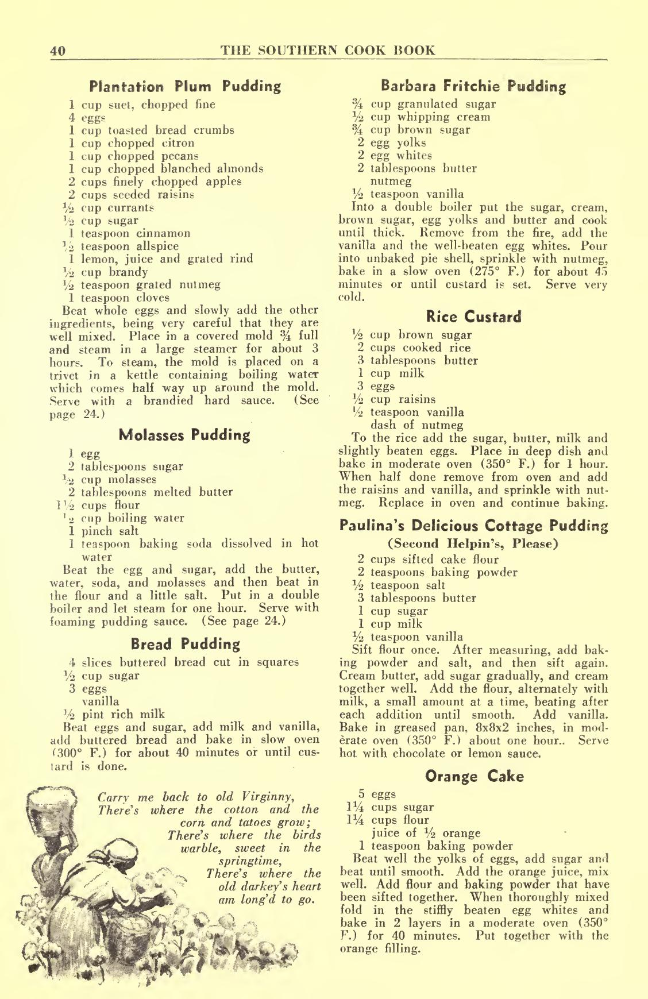

	Receta encontrada en la página 42: Pudín de Ciruela de Plantación
	Receta encontrada en la página 42: Pudín Barbara Fritchie
	Receta encontrada en la página 42: Natillas de Arroz
	Receta encontrada en la página 42: Pudín de Melaza
	Receta encontrada en la página 42: Delicioso Pudín de Requesón de Paulina
	Receta encontrada en la página 42: Pudín de Pan
	Receta encontrada en la página 42: Pastel de Naranja
Recetas correctamente formadas en la página 42: 7
Recetas incorrectamente formadas en la página 42: 0
Procesando página 43


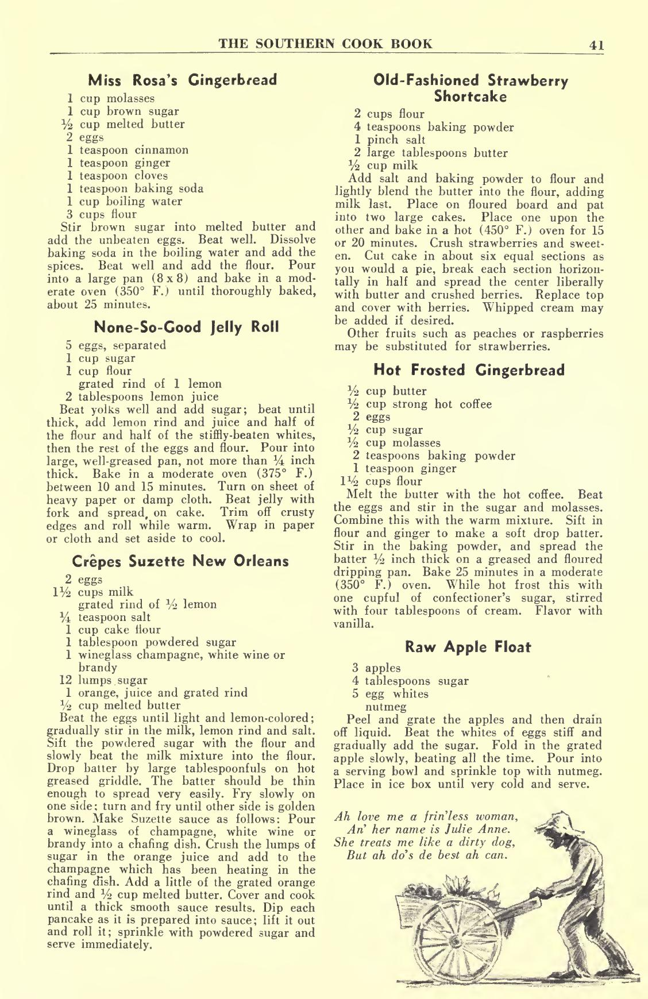

	Receta encontrada en la página 43: Pan de Jengibre de la Señorita Rosa
	Receta encontrada en la página 43: Pastel de Fresa a la Antigua
	Receta encontrada en la página 43: Brazo de Gitano Nada Bueno
	Receta encontrada en la página 43: Pan de Jengibre Glaseado Caliente
	Receta encontrada en la página 43: Crêpes Suzette Nueva Orleans
	Receta encontrada en la página 43: Flotador de Manzana Cruda
Recetas correctamente formadas en la página 43: 6
Recetas incorrectamente formadas en la página 43: 0
Procesando página 44


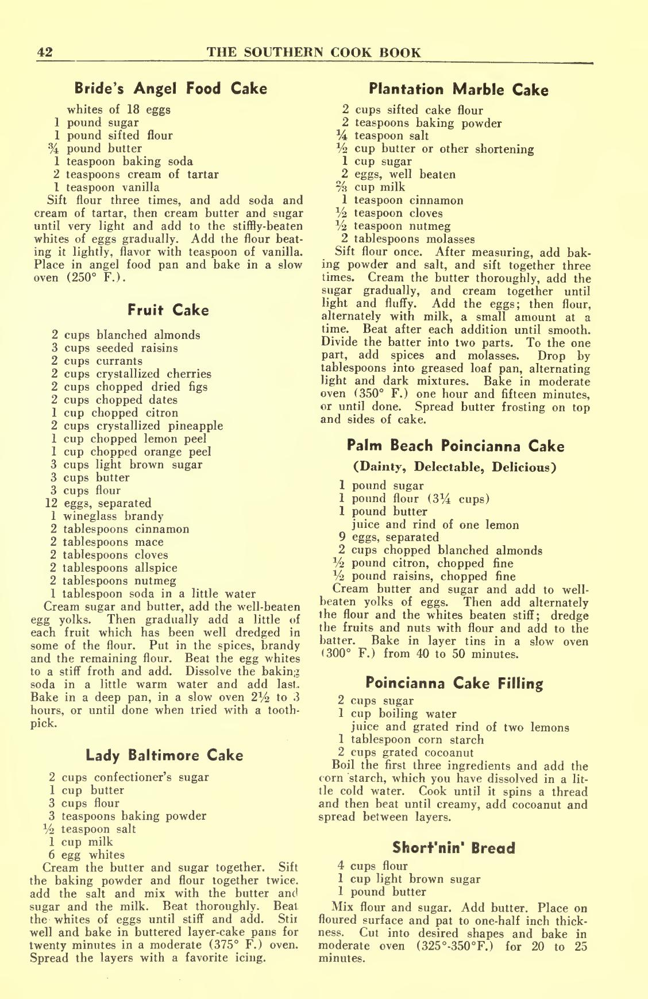

	Receta encontrada en la página 44: Pastel de Ángel de la Novia
	Receta encontrada en la página 44: Pastel de Mármol de Plantación
	Receta encontrada en la página 44: Pastel de Frutas
	Receta encontrada en la página 44: Pastel Poincianna de Palm Beach
	Receta encontrada en la página 44: Relleno de Pastel Poincianna
	Receta encontrada en la página 44: Pastel Lady Baltimore
	Receta encontrada en la página 44: Pan de Mantequilla
Recetas correctamente formadas en la página 44: 7
Recetas incorrectamente formadas en la página 44: 0
Procesando página 45


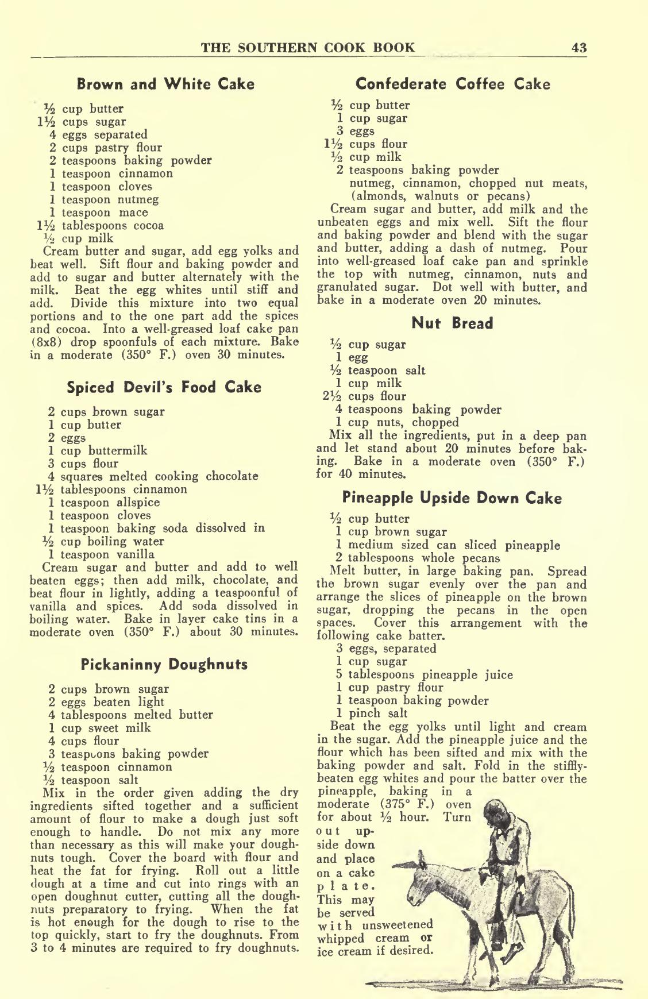

	Receta encontrada en la página 45: Brown and White Cake
	Receta encontrada en la página 45: Confederate Coffee Cake
	Receta encontrada en la página 45: Nut Bread
	Receta encontrada en la página 45: Spiced Devil's Food Cake
	Receta encontrada en la página 45: Pickaninny Doughnuts
	Receta encontrada en la página 45: Pineapple Upside Down Cake
Recetas correctamente formadas en la página 45: 6
Recetas incorrectamente formadas en la página 45: 0
Procesando página 46


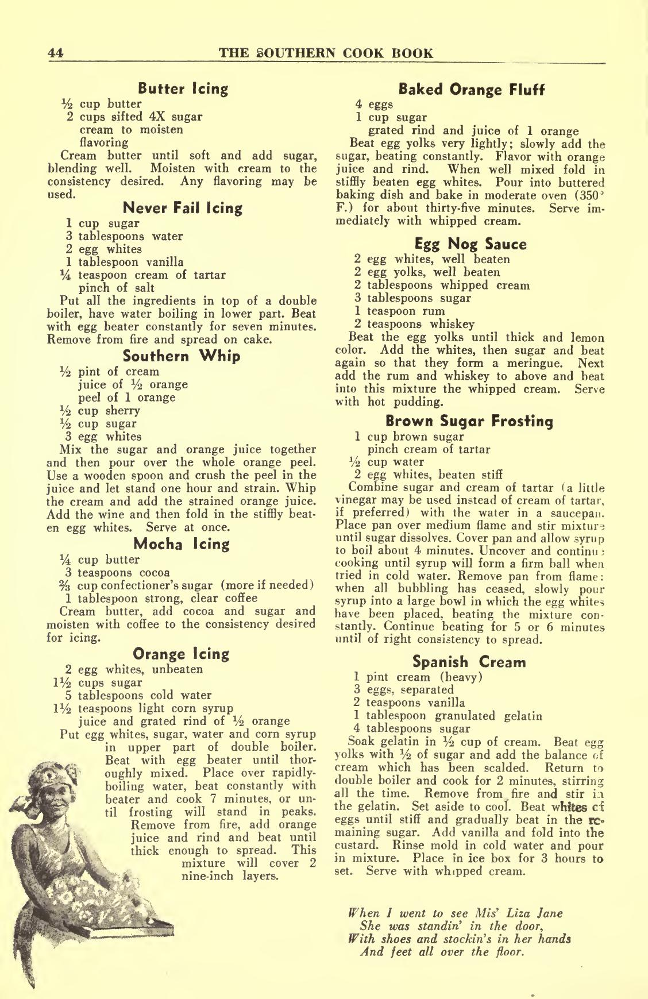

	Receta encontrada en la página 46: Glaseado de Mantequilla
	Receta encontrada en la página 46: Esponjoso de Naranja Horneado
	Receta encontrada en la página 46: Glaseado Infalible
	Receta encontrada en la página 46: Salsa de Ponche de Huevo
	Receta encontrada en la página 46: Batido Sureño
	Receta encontrada en la página 46: Glaseado de Azúcar Morena
	Receta encontrada en la página 46: Glaseado de Moca
	Receta encontrada en la página 46: Glaseado de Naranja
	Receta encontrada en la página 46: Crema Española
Recetas correctamente formadas en la página 46: 9
Recetas incorrectamente formadas en la página 46: 0
Procesando página 47


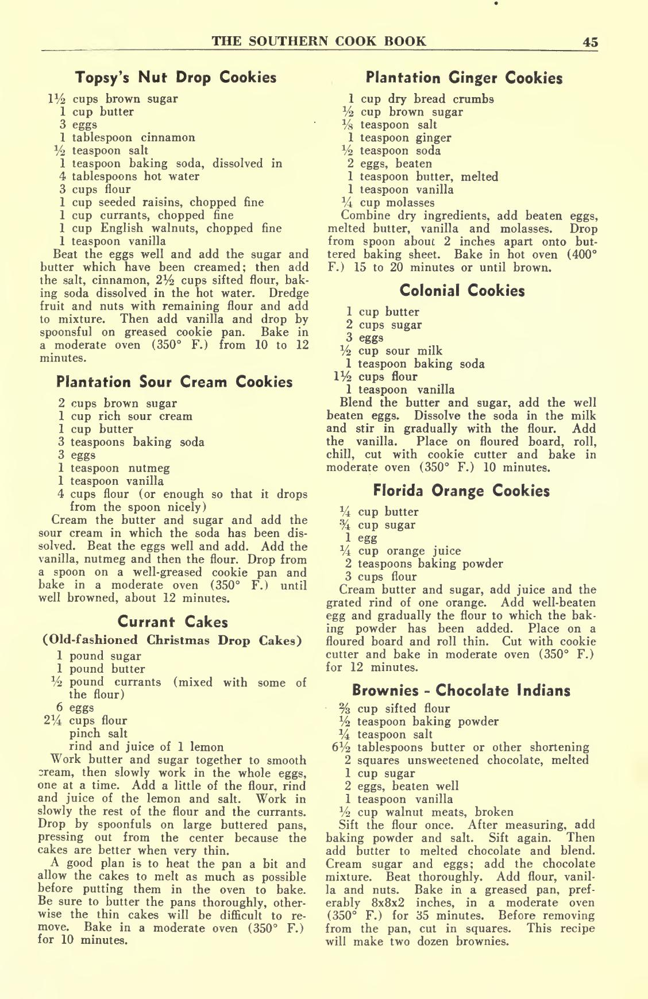

	Receta encontrada en la página 47: Galletas Topsy's Nut Drop
	Receta encontrada en la página 47: Galletas de Jengibre Plantation
	Receta encontrada en la página 47: Galletas Coloniales
	Receta encontrada en la página 47: Galletas de Crema Agria Plantation
	Receta encontrada en la página 47: Galletas de Naranja Florida
	Receta encontrada en la página 47: Pasteles de Grosella (Pasteles de Navidad Antiguos)
	Receta encontrada en la página 47: Brownies - Indios de Chocolate
Recetas correctamente formadas en la página 47: 7
Recetas incorrectamente formadas en la página 47: 0
Procesando página 48


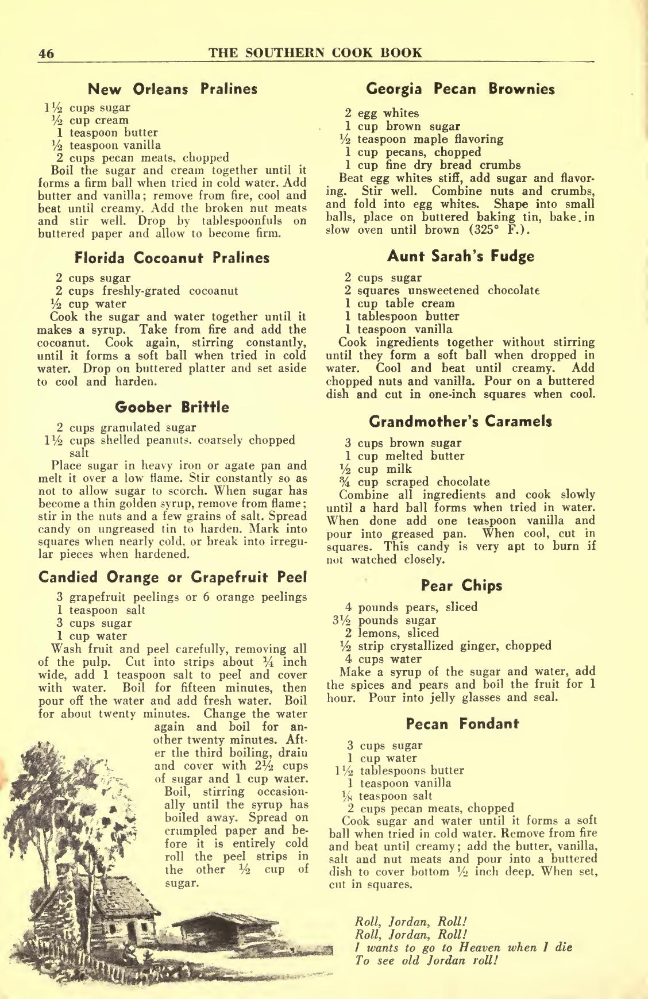

	Receta encontrada en la página 48: Pralinés de Nueva Orleans
	Receta encontrada en la página 48: Brownies de Pecanas de Georgia
	Receta encontrada en la página 48: Pralinés de Coco de Florida
	Receta encontrada en la página 48: Fudge de la Tía Sarah
	Receta encontrada en la página 48: Goober Brittle
	Receta encontrada en la página 48: Caramelos de la Abuela
	Receta encontrada en la página 48: Cáscara de Naranja o Pomelo Confitada
	Receta encontrada en la página 48: Chips de Pera
	Receta encontrada en la página 48: Fondant de Pecanas
Recetas correctamente formadas en la página 48: 9
Recetas incorrectamente formadas en la página 48: 0
Procesando página 49


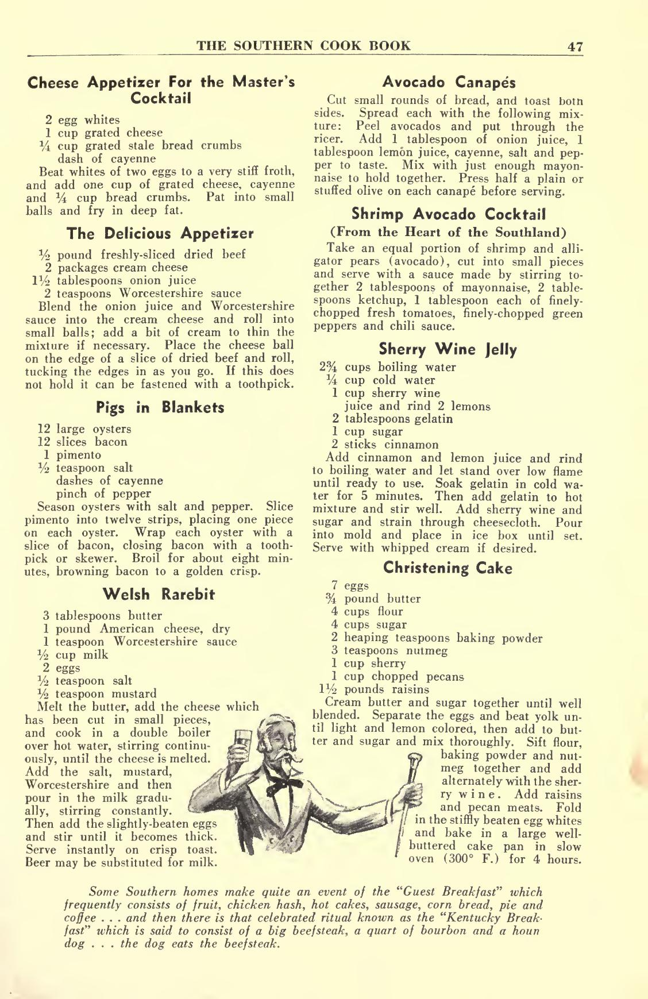

	Receta encontrada en la página 49: Aperitivo de Queso para el Cóctel del Maestro
	Receta encontrada en la página 49: El Delicioso Aperitivo
	Receta encontrada en la página 49: Cerditos en Manta
	Receta encontrada en la página 49: Welsh Rarebit
	Receta encontrada en la página 49: Canapés de Aguacate
	Receta encontrada en la página 49: Cóctel de Camarones y Aguacate
	Receta encontrada en la página 49: Gelatina de Vino Jerez
	Receta encontrada en la página 49: Pastel de Bautizo
Recetas correctamente formadas en la página 49: 8
Recetas incorrectamente formadas en la página 49: 0
Procesando página 50


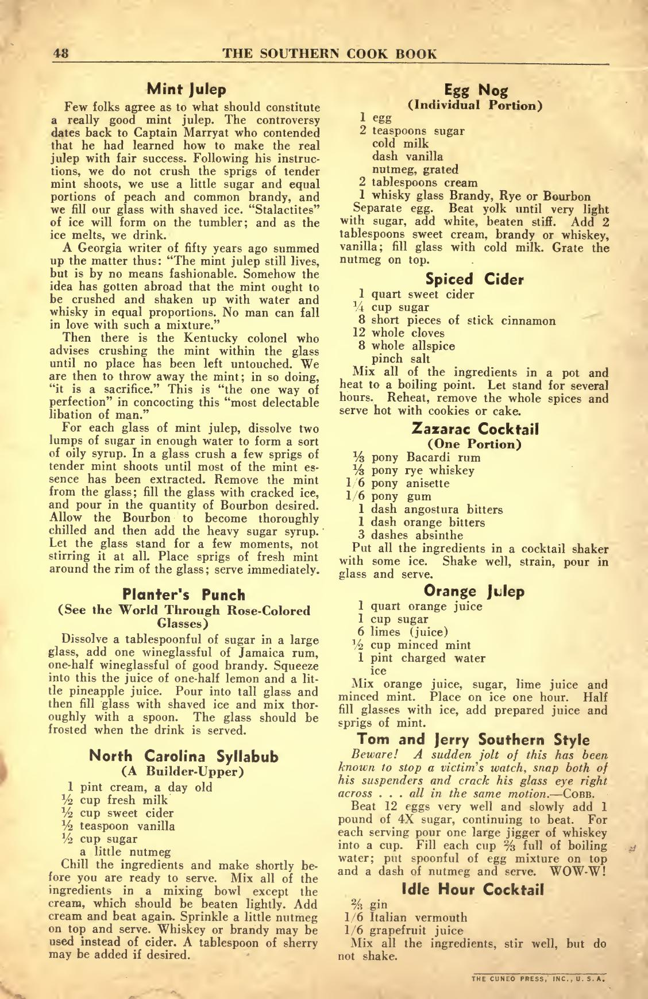

	Receta encontrada en la página 50: Julepe de Menta
	Receta encontrada en la página 50: Ponche de Huevo
	Receta encontrada en la página 50: Sidra Especiada
	Receta encontrada en la página 50: Cóctel Zazarac
	Receta encontrada en la página 50: Ponche del Plantador
	Receta encontrada en la página 50: Julepe de Naranja
	Receta encontrada en la página 50: Syllabub de Carolina del Norte
	Receta encontrada en la página 50: Tom y Jerry Estilo Sureño
	Receta encontrada en la página 50: Cóctel Hora Libre
Recetas correctamente formadas en la página 50: 9
Recetas incorrectamente formadas en la página 50: 0
Procesando página 51


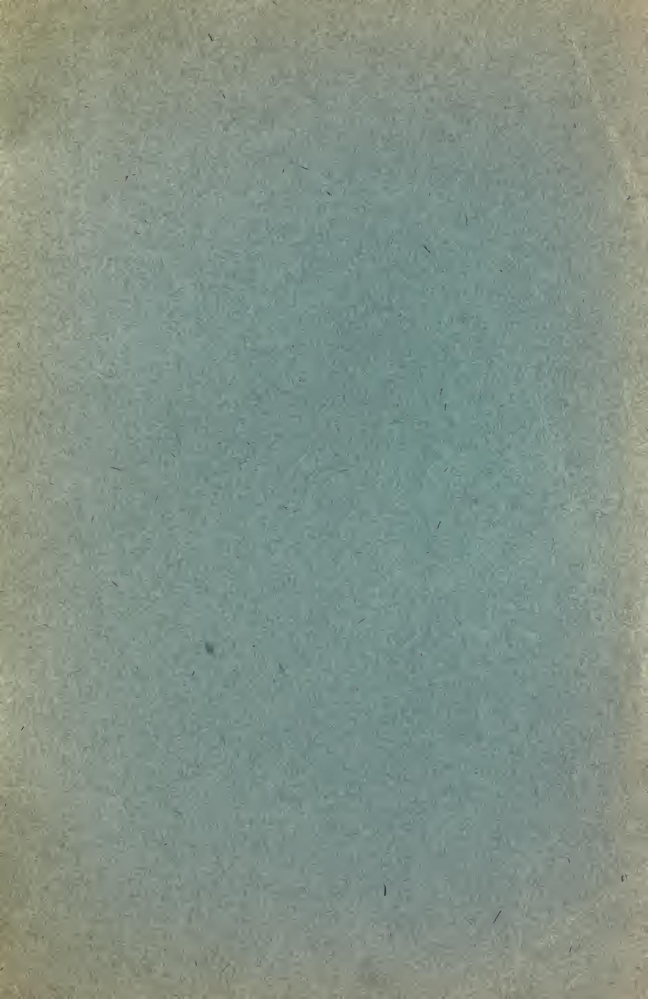

Recetas correctamente formadas en la página 51: 0
Recetas incorrectamente formadas en la página 51: 1
Procesando página 52


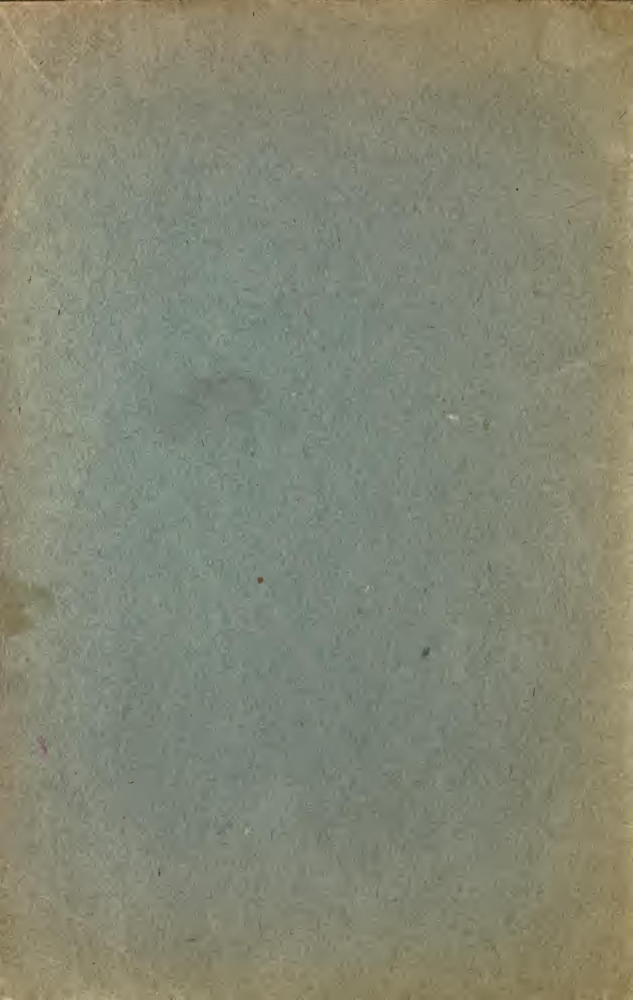

Recetas correctamente formadas en la página 52: 0
Recetas incorrectamente formadas en la página 52: 1


In [24]:
import re

def extract_number(image_file):
    # Busca el primer grupo de dígitos en el nombre del archivo
    match = re.search(r'\d+', image_file)
    return int(match.group()) if match else -1

image_files = sorted([f for f in os.listdir(output_folder) if f.lower().endswith(('.png', '.jpg', '.jpeg'))], key=extract_number)  # Sort files by page number extracted from filename
extracted_recipes = []  # List to store extracted recipes

for image_file in image_files:
  page_number = int(extract_number(image_file))  # Ensure the function is called to extract the number
  print(f"Procesando página {page_number}")
  display(Image(filename=os.path.join(output_folder, image_file), width=150))
  _, recipes = extract_recipes_from_image(page_number = page_number)

  count_true = 0
  count_false = 0

  for recipe in recipes.get("recipes"):
    if recipe.get("is_recipe"):
      print(f"\tReceta encontrada en la página {page_number}: {recipe.get('recipe_name')}")
      extracted_recipes.append(recipe)
      count_true += 1
    else:
        count_false += 1

  print(f"\033[92mRecetas correctamente formadas en la página {page_number}: {count_true}\033[0m")
  print(f"\033[91mRecetas incorrectamente formadas en la página {page_number}: {count_false}\033[0m")


In [25]:
len(extracted_recipes)

314

Almacenamos el resultado en un archivo JSON.

In [26]:
# Define the output file path
output_file = os.path.join("../pdfs", "recipe_info.json")

# Write the filtered list to a json file
with open(output_file, "w") as json_file:
  json.dump(extracted_recipes, json_file, indent = 4)

### Embeddings

A partir de las recetas, vamos a crear los `embeddings` para poder almacenarlos en una base de datos vectorial.

Recuperamos los datos del archivo JSON generado anteriormente, para no tener que volver a procesar las imágenes si reiniciamos el libro.

In [27]:
output_file = os.path.join("../pdfs", "recipe_info.json")

# Write the filtered list to a json file
with open(output_file, "r") as json_file:
  recipes = json.load(json_file)

In [28]:
len(recipes)

314

In [29]:
recipes[0]

{'book_name': 'Southern Cookbook of Fine Recipes',
 'cook_time': '15 a 20 horas',
 'cuisine_type': 'Americana',
 'difficulty': None,
 'dish_type': 'Estofado',
 'ingredients': [{'item': 'carne magra para sopa (sin grasa, sin huesos)',
   'quantity': '600 libras'},
  {'item': 'gallinas gordas', 'quantity': '200 libras'},
  {'item': 'patatas peladas y cortadas en dados', 'quantity': '2000 libras'},
  {'item': 'cebollas', 'quantity': '200 libras'},
  {'item': 'col picada', 'quantity': '5 fanegas'},
  {'item': 'latas de tomate de diez libras', 'quantity': '60'},
  {'item': 'latas de puré de tomate de diez libras', 'quantity': '24'},
  {'item': 'latas de zanahorias de diez libras', 'quantity': '24'},
  {'item': 'latas de maíz de diez libras', 'quantity': '18'},
  {'item': 'pimiento rojo', 'quantity': None},
  {'item': 'sal', 'quantity': None},
  {'item': 'salsa Worcestershire, Tabasco o A#1', 'quantity': None},
  {'item': 'ardillas', 'quantity': '12 docenas'}],
 'instructions': ['Mezclar los

Creamos una función que dada una receta, genere genere el texto para el `embedding` uniendo en un texto el nombre de la receta, los ingredientes y los pasos de la receta.  

In [30]:
def prepare_recipe_for_embedding(recipe):
    """
    Generates the embedding text and metadata dictionary from a recipe dictionary.
    Removes 'is_recipe' from metadata.
    Handles None values for 'quantity' and 'item' in ingredients.
    """
    # Recipe name
    name = recipe.get('recipe_name', '') or ''

    # Ingredients as text
    ingredients_list = recipe.get('ingredients', [])
    ingredients_text = ''
    if ingredients_list and isinstance(ingredients_list, list):
        ingredient_strings = []
        for ing in ingredients_list:
            quantity = ing.get('quantity')
            item = ing.get('item')
            # Only include if item is present (item is essential)
            if item:
                quantity_str = str(quantity) if quantity is not None else ''
                item_str = str(item) if item is not None else ''
                ingredient_strings.append(f"{quantity_str.strip()} {item_str.strip()}".strip())
        ingredients_text = '; '.join(ingredient_strings)

    # Instructions as text
    instructions_list = recipe.get('instructions', [])
    instructions_text = ''
    if instructions_list and isinstance(instructions_list, list):
        instructions_text = ' '.join([str(instr) for instr in instructions_list if instr])

    # Text for embedding
    embedding_text = (
        f"Nombre de la receta: {name}. "
        f"Ingredientes: {ingredients_text}. "
        f"Instrucciones de preparación: {instructions_text}"
    )

    metadata = {}
    for k, v in recipe.items():
        if k == 'is_recipe':
            continue
        if v is None:
            metadata[k] = ''
        elif isinstance(v, (str, int, float, bool)):
            metadata[k] = v
        else:
            # Ignorar valores complejos
            pass

    # Añadir ingredientes como lista de strings
    metadata['ingredients'] = ingredient_strings

    metadata['ingredients'] = ingredients_text
    metadata['instructions'] = instructions_text
    
    return embedding_text, metadata


In [31]:
recipe_text, recipe_metadata = prepare_recipe_for_embedding(recipes[1])
print("Embedding text:\n", recipe_text)
print("\nMetadata:\n", recipe_metadata)


Embedding text:
 Nombre de la receta: Pot Likker. Ingredientes: 3 cuartos agua fría; ½ libra trozo de tocino salado; hojas de nabo tiernas. Instrucciones de preparación: En 3 cuartos de agua fría, poner un trozo de tocino salado de ½ libra y llevar a ebullición durante 45 minutos. Lavar bien las hojas de nabo tiernas en varias aguas y limpiarlas. Poner las hojas de nabo en la olla junto con el tocino y dejar hervir durante otra hora. Escurrir el agua de las hojas de nabo y sazonar bien con sal y pimienta. Colocar en un plato caliente y encima disponer rodajas de tocino; verter sobre las hojas de nabo y la carne aproximadamente 1½ tazas del agua en la que se cocinaron las hojas de nabo (pot likker). Los dodgers de harina de maíz se sirven frecuentemente con este plato y se disponen alrededor de las hojas de nabo.

Metadata:
 {'book_name': 'Southern Cookbook of Fine Recipes', 'cook_time': '1 hora y 45 minutos', 'cuisine_type': 'Americana', 'difficulty': '', 'dish_type': 'Guarnición', 'no

Creamos un cliente de Gemini para generar los embeddings. Observe que la URL es diferente de la habitual.

In [32]:
embedding_client = OpenAI(
    api_key=gemini_api_key,  # Reemplaza por tu clave real de Gemini
    base_url="https://generativelanguage.googleapis.com/v1beta/openai/"
)

Probamos a crear el `embedding` para una receta.

In [33]:
embedding_response = embedding_client.embeddings.create(
    input = recipe_text, # Provide the recipe text as input
    model = "text-embedding-004" # Specify the embedding model to use
)

In [38]:
embedding_response.data

[Embedding(embedding=[-0.009206832386553288, 0.03031449019908905, -0.001422822242602706, 0.013665991835296154, 0.05302012711763382, -0.00022605863341595978, -0.03824576362967491, -0.017513848841190338, 0.04448032006621361, 0.007446850650012493, 0.022568074986338615, 0.09362397342920303, 0.029822058975696564, -0.008347795344889164, 0.019610974937677383, -0.04233422875404358, 0.056508783251047134, 0.03321577608585358, -0.04730343818664551, 0.006919289473444223, 0.008229603059589863, 0.029726391658186913, 0.06894105672836304, -0.06935843825340271, -0.021807348355650902, -0.0083115603774786, -0.003394905012100935, -0.0310564786195755, -0.008276568725705147, -0.04470527544617653, 0.050769250839948654, 0.06425061821937561, 0.0005994950770400465, 0.01999463513493538, 0.013579154387116432, 0.03484592214226723, -0.040459372103214264, -0.019918017089366913, 0.010805109515786171, -0.03134416043758392, -0.05594518780708313, -0.008777963928878307, 0.005848380737006664, 0.0031282000709325075, -0.019

Vamos a crear los `embeddings` de todas las recetas:

In [39]:
recipes_text, recipes_metadata = map(list, zip(*(prepare_recipe_for_embedding(recipe) for recipe in recipes)))

len(recipes_text)

314

El modelo `text-embedding-004` sólo permite crear `embeddings` para 100 elementos. Dividimos el proceso en bloques y unimos.

In [40]:
def batch_embedding_calls(texts, embedding_function, batch_size=100):
    """
    Procesa textos en lotes y concatena los resultados de embeddings.
    - texts: lista de textos a procesar.
    - embedding_function: función que recibe una lista de textos y devuelve una lista de embeddings.
    - batch_size: máximo de textos por llamada (100 para text-embedding-004).
    """
    batches = [texts[i:i + batch_size] for i in range(0, len(texts), batch_size)]
    all_embeddings = []
    for batch in batches:
        embeddings = embedding_function(batch)  # Llama a la API aquí
        all_embeddings.extend(embeddings)
    return all_embeddings

def get_embeddings(text_batch):
    response = embedding_client.embeddings.create(
        input = text_batch, # Provide the recipe text as input
        model = "text-embedding-004" # Specify the embedding model to use
    )
    return [item.embedding for item in response.data]

In [41]:
recipes_embedding = batch_embedding_calls(recipes_text, get_embeddings, batch_size=100)


### Almacenamiento en una base de datos vectorial

El siguiente paso es almacenar los `embeddings` y los metadatos en una base de datos vectorial. En este caso, usaremos ChromaDB.

Creamos el cliente de ChromaDB.

In [43]:
import chromadb

chroma_client = chromadb.PersistentClient(path="db/recipes")

Creamos la colección de recetas. Si ya existe, la eliminamos y la volvemos a crear.

In [44]:
collection_name = "recipes"

if collection_name in [c.name for c in chroma_client.list_collections()]:
    chat_client.delete_collection(name=collection_name)

recipes_collection = chroma_client.create_collection(name=collection_name)

In [45]:
collection_name = "recipes"

recipes_collection = chroma_client.get_collection(name=collection_name)

Insertamos los datos en la colección. Cada elemento en Chroma debe tener un identificador único.

In [46]:
import uuid

recipes_ids = [str(uuid.uuid4()) for _ in recipes]


In [47]:
recipes_collection.add(
    ids=recipes_ids,                # Lista de IDs únicos (str)
    embeddings=recipes_embedding,  # Lista de vectores (listas de floats)
    documents=recipes_text,         # Lista de textos originales (opcional, pero recomendable)
    metadatas=recipes_metadata      # Lista de diccionarios de metadatos (opcional)
)

### Consultar la base de datos vectorial

Primero, generamos el `embedding` de la consulta.

In [48]:
# Generate the embeddings for the query
query = "¿Cómo se hace pan?"

query_embedding = embedding_client.embeddings.create(
    input = [query],
    model = "text-embedding-004"
).data[0].embedding

Después consultados la base de datos vectorial con el `embedding` de la consulta.

In [49]:
k = 5 # Number of top results to retrieve
results = recipes_collection.query(
    query_embeddings=[query_embedding],
    n_results=k,
    include=["documents", "metadatas", "distances"]  # Puedes incluir lo que necesites
)

Se muestran los 5 resultados más relevantes ordenados de menor a mayor distancia.

In [50]:
results

{'ids': [['b18579eb-1b52-4ac9-b8b1-64099d17697b',
   '2281c212-ab02-4fa7-88f9-ab9ccad27dcf',
   'f48350b7-2e2d-4f24-8f3d-3235a1b999a8',
   'f02f5777-d5a2-4d77-a25c-f83fec571953',
   '4caa362d-7909-462f-a6c2-926f74fe8e0a']],
 'embeddings': None,
 'documents': [['Nombre de la receta: Pudín de Pan. Ingredientes: 4 rebanadas de pan con mantequilla cortadas en cuadrados; 1/2 taza azúcar; 3 huevos; vainilla; 1/4 pinta leche rica. Instrucciones de preparación: Batir los huevos y el azúcar, añadir la leche y la vainilla, añadir el pan con mantequilla y hornear en horno lento (300° F.) durante unos 40 minutos o hasta que la natilla esté lista.',
   'Nombre de la receta: Relleno de Pan. Ingredientes: 1 cuarto pan duro; 1 cucharadita sal; ¼ cucharadita pimienta negra; ¼ cucharadita condimento para aves; 1 cucharadita perejil picado; ½ cucharadita cebolla picada fina; 2 cucharadas grasa derretida; 1 huevo; corazón, hígado y molleja de ave o salchicha de cerdo o hígado picados finos y parcialmente 

Creamos una función que reciba un `document` y lo muestre formateado en Markdown.

In [51]:
def recipe_document_to_markdown(doc_str):
    """
    Recibe un string con la receta y devuelve Markdown con nombre, ingredientes e instrucciones.
    """
    # Extraer nombre de la receta
    name_match = re.search(r'Nombre de la receta:\s*([^.]+)\.', doc_str)
    name = name_match.group(1).strip() if name_match else "Receta sin nombre"

    # Extraer ingredientes
    ing_match = re.search(r'Ingredientes:\s*([^.]+)\.', doc_str)
    ingredients_raw = ing_match.group(1).strip() if ing_match else ""
    # Separar ingredientes por ';'
    ingredients = [f"- {ing.strip()}" for ing in ingredients_raw.split(';') if ing.strip()]

    # Extraer instrucciones
    instr_match = re.search(r'Instrucciones de preparación:\s*(.+)', doc_str)
    instructions_raw = instr_match.group(1).strip() if instr_match else ""
    # Separar instrucciones por puntos, pero mantener frases completas
    # (puedes ajustar esto según tus necesidades)
    instructions = [f"{i+1}. {step.strip()}" for i, step in enumerate(re.split(r'\.([ ]|$)\s*', instructions_raw)) if step.strip()]

    # Construir el Markdown
    md = f"# {name}\n\n"
    md += "## Ingredientes\n"
    md += "\n".join(ingredients) + "\n\n"
    md += "## Instrucciones de preparación\n"
    md += "\n".join(instructions)

    return md


In [52]:
display(Markdown(recipe_document_to_markdown(results["documents"][0][-1])))

# Pan de Masa, Estilo Mulato

## Ingredientes
- 1 huevo
- 1/2 taza hominy frío
- 1 cucharadita sal
- 1/2 pinta harina de maíz
- 1 cucharada manteca de cerdo

## Instrucciones de preparación
1. Mezclar el hominy frío, el huevo batido, la harina de maíz y la sal con suficiente agua hirviendo para hacer una masa con la consistencia de la leche
3. Poner la manteca de cerdo en una fuente de horno profunda y calentar hasta que humee
5. Verter en esta manteca caliente la masa fría
7. La manteca derretida burbujeará por el lado de la sartén, formando una deliciosa corteza
9. Hornear en un horno moderado (350° F.) durante unos cuarenta minutos

Creamos una función que reciba todos los `documents` y los muestre formateados los documentos en Markdown en orden de distancia.

In [53]:
def recipe_documents_to_markdown(documents):
    """
    Convierte una lista de documentos de recetas a Markdown.
    """
    return "\n\n".join(recipe_document_to_markdown(doc) for doc in reversed(documents))

In [54]:
display(Markdown(recipe_documents_to_markdown(results["documents"][0])))

# Pan de Masa, Estilo Mulato

## Ingredientes
- 1 huevo
- 1/2 taza hominy frío
- 1 cucharadita sal
- 1/2 pinta harina de maíz
- 1 cucharada manteca de cerdo

## Instrucciones de preparación
1. Mezclar el hominy frío, el huevo batido, la harina de maíz y la sal con suficiente agua hirviendo para hacer una masa con la consistencia de la leche
3. Poner la manteca de cerdo en una fuente de horno profunda y calentar hasta que humee
5. Verter en esta manteca caliente la masa fría
7. La manteca derretida burbujeará por el lado de la sartén, formando una deliciosa corteza
9. Hornear en un horno moderado (350° F.) durante unos cuarenta minutos

# Pan de Mantequilla

## Ingredientes
- 4 tazas harina
- 1 taza azúcar moreno claro
- 1 libra mantequilla

## Instrucciones de preparación
1. Mezcle la harina y el azúcar
3. Añada la mantequilla
5. Coloque sobre una superficie enharinada y extienda hasta un grosor de media pulgada
7. Corte en las formas deseadas y hornee en un horno moderado (325°-350°F.) durante 20 a 25 minutos

# Aderezo de Pan de Maíz

## Ingredientes
- 3 huevos
- 2 tazas suero de leche
- 3 cucharadas manteca derretida
- 2 cucharaditas sal
- 2½ tazas harina tamizada
- 3 cucharaditas polvo para hornear
- 1 cucharadita bicarbonato de sodio
- 1 cucharada agua
- 3 cucharadas mantequilla derretida
- agua caliente
- cebolla
- perejil
- apio
- sal
- pimienta

## Instrucciones de preparación
1. A los huevos bien batidos, añadir la leche, la manteca y la sal
3. Cernir juntos el polvo para hornear y la harina y añadir lentamente a la mezcla de huevo, añadiendo suficiente harina para hacer una masa media
5. Batir bien
7. Disolver el bicarbonato de sodio en 1 cucharada de agua y añadir a la masa
9. Verter la masa en un molde para hornear poco profundo engrasado
11. Hornear en un horno caliente (425° F.) durante unos 20 a 25 minutos, o hasta que el pan empiece a dorarse
13. Dejar enfriar el pan; luego romperlo en trozos pequeños, desmenuzando bien la corteza
15. Añadir la mantequilla derretida y sazonar con cebolla, apio, sal y pimienta o cualquier otro condimento deseado
17. Humedecer bien con agua caliente
19. Rellenar el pavo o la gallina y asar según sea necesario

# Relleno de Pan

## Ingredientes
- 1 cuarto pan duro
- 1 cucharadita sal
- ¼ cucharadita pimienta negra
- ¼ cucharadita condimento para aves
- 1 cucharadita perejil picado
- ½ cucharadita cebolla picada fina
- 2 cucharadas grasa derretida
- 1 huevo
- corazón, hígado y molleja de ave o salchicha de cerdo o hígado picados finos y parcialmente hervidos

## Instrucciones de preparación
1. Remojar 1 cuarto de pan duro en agua fría y escurrirlo
3. Sazonar con los siguientes ingredientes: 1 cucharadita de sal, ¼ cucharadita de pimienta negra, ¼ cucharadita de condimento para aves, 1 cucharadita de perejil picado, ½ cucharadita de cebolla picada fina (las cebollas pueden omitirse si se desea)
5. Añadir 2 cucharadas de grasa derretida y mezclar bien
7. Batir 1 huevo ligeramente y añadir a la mezcla anterior
9. Luego añadir el corazón, el hígado y la molleja de ave o la salchicha de cerdo o hígado picados finos y parcialmente hervidos

# Pudín de Pan

## Ingredientes
- 4 rebanadas de pan con mantequilla cortadas en cuadrados
- 1/2 taza azúcar
- 3 huevos
- vainilla
- 1/4 pinta leche rica

## Instrucciones de preparación
1. Batir los huevos y el azúcar, añadir la leche y la vainilla, añadir el pan con mantequilla y hornear en horno lento (300° F.) durante unos 40 minutos o hasta que la natilla esté lista

Creamos una función que realiza todo el proceso

In [55]:
def search_recipes(query, k=5):
    """
    Busca recetas similares a la consulta dada.
    
    Args:
        query (str): Consulta de búsqueda.
        k (int): Número de resultados a devolver.
    
    Returns:
        list: Lista de documentos de recetas encontrados.
    """
    query_embedding = embedding_client.embeddings.create(
        input=[query],
        model="text-embedding-004"
    ).data[0].embedding

    results = recipes_collection.query(
        query_embeddings=[query_embedding],
        n_results=k,
        include=["documents", "metadatas", "distances"]
    )
    
    return recipe_documents_to_markdown(results["documents"][0])  # Devuelve los documentos encontrados

In [56]:
display(Markdown(search_recipes("¿Cómo se hace pan?")))

# Pan de Masa, Estilo Mulato

## Ingredientes
- 1 huevo
- 1/2 taza hominy frío
- 1 cucharadita sal
- 1/2 pinta harina de maíz
- 1 cucharada manteca de cerdo

## Instrucciones de preparación
1. Mezclar el hominy frío, el huevo batido, la harina de maíz y la sal con suficiente agua hirviendo para hacer una masa con la consistencia de la leche
3. Poner la manteca de cerdo en una fuente de horno profunda y calentar hasta que humee
5. Verter en esta manteca caliente la masa fría
7. La manteca derretida burbujeará por el lado de la sartén, formando una deliciosa corteza
9. Hornear en un horno moderado (350° F.) durante unos cuarenta minutos

# Pan de Mantequilla

## Ingredientes
- 4 tazas harina
- 1 taza azúcar moreno claro
- 1 libra mantequilla

## Instrucciones de preparación
1. Mezcle la harina y el azúcar
3. Añada la mantequilla
5. Coloque sobre una superficie enharinada y extienda hasta un grosor de media pulgada
7. Corte en las formas deseadas y hornee en un horno moderado (325°-350°F.) durante 20 a 25 minutos

# Aderezo de Pan de Maíz

## Ingredientes
- 3 huevos
- 2 tazas suero de leche
- 3 cucharadas manteca derretida
- 2 cucharaditas sal
- 2½ tazas harina tamizada
- 3 cucharaditas polvo para hornear
- 1 cucharadita bicarbonato de sodio
- 1 cucharada agua
- 3 cucharadas mantequilla derretida
- agua caliente
- cebolla
- perejil
- apio
- sal
- pimienta

## Instrucciones de preparación
1. A los huevos bien batidos, añadir la leche, la manteca y la sal
3. Cernir juntos el polvo para hornear y la harina y añadir lentamente a la mezcla de huevo, añadiendo suficiente harina para hacer una masa media
5. Batir bien
7. Disolver el bicarbonato de sodio en 1 cucharada de agua y añadir a la masa
9. Verter la masa en un molde para hornear poco profundo engrasado
11. Hornear en un horno caliente (425° F.) durante unos 20 a 25 minutos, o hasta que el pan empiece a dorarse
13. Dejar enfriar el pan; luego romperlo en trozos pequeños, desmenuzando bien la corteza
15. Añadir la mantequilla derretida y sazonar con cebolla, apio, sal y pimienta o cualquier otro condimento deseado
17. Humedecer bien con agua caliente
19. Rellenar el pavo o la gallina y asar según sea necesario

# Relleno de Pan

## Ingredientes
- 1 cuarto pan duro
- 1 cucharadita sal
- ¼ cucharadita pimienta negra
- ¼ cucharadita condimento para aves
- 1 cucharadita perejil picado
- ½ cucharadita cebolla picada fina
- 2 cucharadas grasa derretida
- 1 huevo
- corazón, hígado y molleja de ave o salchicha de cerdo o hígado picados finos y parcialmente hervidos

## Instrucciones de preparación
1. Remojar 1 cuarto de pan duro en agua fría y escurrirlo
3. Sazonar con los siguientes ingredientes: 1 cucharadita de sal, ¼ cucharadita de pimienta negra, ¼ cucharadita de condimento para aves, 1 cucharadita de perejil picado, ½ cucharadita de cebolla picada fina (las cebollas pueden omitirse si se desea)
5. Añadir 2 cucharadas de grasa derretida y mezclar bien
7. Batir 1 huevo ligeramente y añadir a la mezcla anterior
9. Luego añadir el corazón, el hígado y la molleja de ave o la salchicha de cerdo o hígado picados finos y parcialmente hervidos

# Pudín de Pan

## Ingredientes
- 4 rebanadas de pan con mantequilla cortadas en cuadrados
- 1/2 taza azúcar
- 3 huevos
- vainilla
- 1/4 pinta leche rica

## Instrucciones de preparación
1. Batir los huevos y el azúcar, añadir la leche y la vainilla, añadir el pan con mantequilla y hornear en horno lento (300° F.) durante unos 40 minutos o hasta que la natilla esté lista

### Sistema generativo

Ya tenemos las recetas que más se parecen a nuestra consulta. Pero eso no quiere decir que hayamos respondido a la pregunta. Vamos consultar a un LLM para que nos responda a la pregunta, pero que sólo use la información obtenida de las recetas.

In [57]:
# Define el prompt del sistema
def query_system_prompt(combined_content, query):
    return f"""
    Eres un chef altamente experimentado y experto, especializado en brindar consejos culinarios.
    Tu tarea principal es proporcionar información precisa y exacta sobre el contenido combinado.
    Tu objetivo es ayudar al usuario y responder la pregunta: "{query}"
    Respondes directamente a la consulta utilizando solo la información proporcionada en las
    siguientes recetas: [recetas].
    Si no sabes la respuesta, simplemente di que no lo sabes.
    El usuario no debe saber que consultas la información en una lista de recetas.
    No hagas aclaraciones al usuario si no sabes la respuesta.

    recetas: {combined_content}
    """


In [58]:
def generate_response(query, combined_content):
  response = chat_client.chat.completions.create(
      model = model,
      messages = [
          {"role": "system", "content": query_system_prompt(combined_content, query)}, # Provide system prompt for guidance
          {"role": "user", "content": query}
    ],
    temperature=0
  )
  return response

In [59]:
# Get the results from the API
query = "¿Cómo se hace masa de pan?"
combined_content = search_recipes(query)
response = generate_response(query, combined_content)

display(Markdown(response.choices[0].message.content))

Para hacer masa de pan, generalmente se siguen estos pasos:

1.  Primero, cierna los ingredientes secos juntos. Estos pueden incluir harina (ya sea de maíz o de trigo), levadura en polvo, polvo para hornear, bicarbonato de sodio y sal.
2.  En un recipiente aparte, combine los ingredientes húmedos. Esto puede implicar batir huevos, añadir leche o suero de leche, y grasas como mantequilla o manteca derretida.
3.  Luego, incorpore lentamente la mezcla de ingredientes húmedos a los secos. Añada suficiente harina para lograr una masa de consistencia media, o mezcle con agua hirviendo hasta obtener la consistencia deseada. Asegúrese de batir bien la mezcla.
4.  Si la receta lo indica, puede disolver bicarbonato de sodio en un poco de agua y añadirlo a la masa.
5.  Finalmente, la masa puede ser vertida en un molde bien engrasado o, si es una masa más firme, colocada sobre una superficie enharinada y extendida.

In [61]:
# Get the results from the API
query = "Dime la mejor receta de pastel de chocolate"
combined_content = search_recipes(query)
response = generate_response(query, combined_content)

display(Markdown(response.choices[0].message.content))

No lo sé.

In [62]:
# Get the results from the API
query = "Dime recetas con tortuga y cebolla. Muestra las palabras que hagan referencia a tortuga y cebolla en verde"
combined_content = search_recipes(query)
response = generate_response(query, combined_content)

display(Markdown(response.choices[0].message.content))

Aquí tienes las recetas que incluyen tanto tortuga como cebolla:

# Estofado de Tortuga Diamante (Estilo Bahía de Chesapeake)

## Ingredientes
- 3 <span style="color: green;">tortuga</span> (grande)
- 6 huevos duros
- 3 cucharadas harina
- 1/2 nuez moscada rallada
- 1 <span style="color: green;">cebolla</span>, en rodajas
- 1/2 taza mantequilla
- 1 limón, jugo y ralladura
- 2 tazas jerez de cocina
- 1 cucharada salsa Worcestershire
- caldo de sopa
- pimienta roja
- sal
- 2 tallos apio
- leche caliente

## Instrucciones de preparación
1. Sumergir la <span style="color: green;">tortuga</span> viva en agua hirviendo y dejar reposar durante 5 minutos
3. Retirar del agua, frotar la piel de las patas, la cola y la cabeza con una toalla, sacando la cabeza con un pincho
5. Cortar las garras
7. Fregar el caparazón con agua hirviendo
9. Romper el caparazón con un hacha afilada
11. Retirar la carne y el hígado
13. Desechar la vesícula biliar, el corazón, el saco de arena y las entrañas
15. Cortar el hígado en rodajas finas
17. Sacar los huevos, quitar la película y reservar los huevos en agua fría
19. Combinar las yemas de huevo, la <span style="color: green;">cebolla</span>, el apio y la harina y el caldo de sopa (suficiente para cubrir la carne), añadir el limón, la nuez moscada, los huevos de <span style="color: green;">tortuga</span> y la carne
21. Luego añadir la crema, el vino de jerez, la salsa Worcestershire y los condimentos
23. Añadir las claras de huevo picadas y suficiente leche caliente para diluir si el estofado se vuelve demasiado espeso
25. Dejar cocer a fuego lento en una olla doble hasta que la carne se desprenda de los huesos (unos 15 minutos)
27. Retirar todos los huesos antes de servir
29. Servir en un plato de chafing con tostadas al lado

# Sopa de Tortuga Pendennis

## Ingredientes
- 2 libras huesos de ternera
- 2 zanahorias
- 2 <span style="color: green;">cebollas</span>
- 2 cucharadas mantequilla
- 3 cucharadas harina
- 2 cuartos caldo de res o agua
- 1 lata pequeña tomates enlatados pequeños
- 1 lata pequeña puré de tomate enlatado pequeño
- sal y pimienta
- clavos enteros
- ½ taza jerez
- 2 tazas carne de <span style="color: green;">tortuga</span> fresca hervida
- 1 limón
- 2 huevos duros

## Instrucciones de preparación
1. Asar los huesos y las verduras con la mantequilla hasta que estén dorados
3. Añadir la harina y dorar de nuevo
5. Añadir agua o caldo de res, tomates y puré de tomate, sal, pimienta negra al gusto y unos cuantos clavos enteros
7. Hervir durante dos horas
9. Añadir vino de jerez
11. Colar la sopa a través de una gasa
13. Luego añadir la carne de <span style="color: green;">tortuga</span> hervida cortada en cuadrados pequeños, limón y huevos, también cortados en cuadrados pequeños, hervir rápidamente y servir